<a href="https://colab.research.google.com/github/Inno732/Defi_IA_1_2023_2024/blob/main/Copie_de_4_XAI_Gradcam_classification_tf_2023.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**1. Intaller le module d'explicabilité "tf-explain"**

In [1]:
!pip install tf-explain

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.6/43.6 kB 862.6 kB/s eta 0:00:00


#**2. Importer les libraries**

In [2]:
from matplotlib import pyplot as plt
import numpy as np
import tensorflow as tf
import tf_explain
from tf_explain.core.grad_cam import GradCAM
from tf_explain.core.smoothgrad import SmoothGrad
from keras.models import load_model
import cv2

#**3. Télécharger la base d'images de test**

In [ ]:
!rm -rf sample_data
!wget https://nextcloud.ig.umons.ac.be/s/RsZpqtYfDgYzKxr/download/test.zip
!unzip test.zip
! rm test.zip

In [4]:
!printf '%s\n' 'fire' 'no_fire' 'start_fire'> classes.txt

In [5]:
dataset_name='test'
#test_dataset = os.path.join('bases/', dataset_name)
classes_path = "classes.txt"

In [6]:
test_ds = tf.keras.preprocessing.image_dataset_from_directory(
	dataset_name,
	batch_size= 8,      # Taille du mini-batch
  label_mode= 'categorical'    # Conversion au format One-Hot
)                             # Generates a 'tf.data.Dataset' from image files in a directory (train_dataset)
print(test_ds.class_names)

Found 300 files belonging to 3 classes.
['fire', 'no_fire', 'start_fire']


#**4. Télécharger votre modèle**

In [ ]:
!wget https://nextcloud.ig.umons.ac.be/s/p2xNRJZqZ5zCrW6/download/small_MobileNetV2_2023_test.h5

In [ ]:
!wget https://nextcloud.ig.umons.ac.be/s/p2xNRJZqZ5zCrW6/download/model_VGG16_8r5eqnu.h5

In [ ]:
!wget https://nextcloud.ig.umons.ac.be/s/p2xNRJZqZ5zCrW6/download/model_VGG19_epD3OKv.h5
!wget https://nextcloud.ig.umons.ac.be/s/p2xNRJZqZ5zCrW6/download/model_rsnt50.h5
!wget https://nextcloud.ig.umons.ac.be/s/p2xNRJZqZ5zCrW6/download/model_xception_1.h5
!wget https://nextcloud.ig.umons.ac.be/s/p2xNRJZqZ5zCrW6/download/model_DsNt121_1.h5

In [10]:
# Load pretrained model or your own
model = load_model("small_MobileNetV2_2023_test.h5")

In [11]:
model_VGG16 = load_model("model_VGG16_8r5eqnu.h5")

In [12]:
model_VGG19 = load_model("model_VGG19_epD3OKv.h5")

In [13]:
model_DsNt121 = load_model("model_DsNt121_1.h5")

In [14]:
model_rsnt50 = load_model("model_rsnt50.h5")

In [15]:
model_xception = load_model("model_xception_1.h5")

In [16]:
input_dim =224

#**5. Définir la classe à expliquer**

In [17]:
className="Fire"
#className="start_fire"
!mkdir -p className/className

In [18]:
classes = test_ds.class_names

#**6. Sélectionner 3 images de test**

In [70]:
images_to_test = ["test/fire/test019.jpg",
                  "test/fire/test002.jpg",
                  "test/fire/test005.jpg",
                  "test/fire/test013.jpg",
                  "test/fire/test007.jpg",
                  "test/fire/F_2062.jpg",
                  "test/fire/F_2063.jpg",
                  "test/fire/F_2064.jpg",
                  "test/fire/F_2066.jpg",
                  "test/fire/F_2067.jpg",
                  "test/fire/F_2080.jpg",
                  "test/no_fire/img31.jpg",
                  "test/fire/F_2062.jpg",
                  "test/start_fire/test101.jpg",
                  "test/start_fire/test122.jpg",
                  "test/start_fire/NorthAmerica (79).png",
                  "test/start_fire/test106.jpg",
                  "test/start_fire/test118.jpg",
]

#**4. Expliquer le modèle avec la méthode XAI "GradCAM"**

In [ ]:
for image_path in images_to_test:
    #imnum=[]
    print(image_path)
    # Load to the correct format and predict the current image
    img0 = tf.keras.preprocessing.image.load_img(image_path, target_size=(input_dim,input_dim))
    img = tf.keras.preprocessing.image.img_to_array(img0)

    data = ([img], None)
    xy=np.expand_dims(img,axis=0)
    myTuple=(xy,None)

    # Start explainer
    #explainer = SmoothGrad()
    explainer = GradCAM()
    grid = explainer.explain(myTuple, model_VGG16, class_index=1)
    temp = np.concatenate((img,grid),axis=1)
    fig, axs = plt.subplots(1, 3)
    axs[0].imshow(img.astype(np.uint8))
    axs[0].set_title("input")
    axs[1].imshow(grid.astype(np.uint8))
    axs[1].set_title("XAI")

    fig.set_figheight(15)
    fig.set_figwidth(15)


    pred_VGG16 = model_VGG16.predict(xy,batch_size=1)[0]
    print(pred_VGG16)
    for (pos,prob) in enumerate(pred_VGG16):
      pos == np.argmax(pred_VGG16)
      img = cv2.imread(image_path)
      img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
      font = cv2.FONT_HERSHEY_COMPLEX
      textsize = cv2.getTextSize(className, font, 0.7, 2)[0]
      textX = (img.shape[1] - textsize[0]) / 2
      textY = (img.shape[0] + textsize[1]) / 2
      cv2.putText(img, classes[np.argmax(pred_VGG16)], (int(textX), int(textY)), font, 4.7, (255,255,255), 5, cv2.LINE_AA)
      axs[2].imshow(img)
    plt.show()

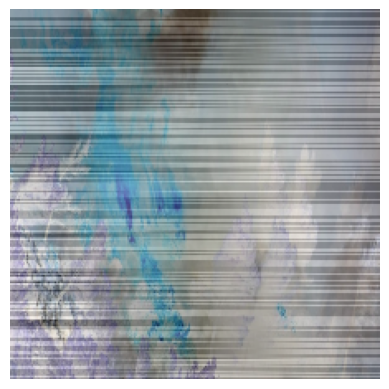

In [72]:
from tensorflow.keras.applications.vgg16 import preprocess_input
from tf_explain.core.grad_cam import GradCAM

# Load the VGG16 model
model_VGG16 = load_model("model_VGG16_8r5eqnu.h5")

# Function to compute Grad-CAM heatmap for a given image path and model
def compute_grad_cam(image_path, model):
    img = tf.keras.preprocessing.image.load_img(image_path, target_size=(224, 224))
    img_array = tf.keras.preprocessing.image.img_to_array(img)
    img_array = preprocess_input(img_array)
    img_array = np.expand_dims(img_array, axis=0)

    # Create a GradCAM explainer
    explainer = GradCAM()

    # Compute Grad-CAM heatmap for the 'fire' class (assuming index 1)
    grid = explainer.explain((img_array, None), model, class_index=1)

    return grid[0]  # Select the heatmap for the first image in the batch

# Example usage for one image
image_path = "test/fire/test019.jpg"
heatmap_VGG16 = compute_grad_cam(image_path, model_VGG16)

# Load the original image
original_image = tf.keras.preprocessing.image.load_img(image_path, target_size=(224, 224))
original_image = tf.keras.preprocessing.image.img_to_array(original_image)

# Rescale the heatmap to match the original image size
heatmap_rescaled = cv2.resize(heatmap_VGG16, (224, 224))

# Normalize the heatmap to values between 0 and 1
heatmap_rescaled = heatmap_rescaled - np.min(heatmap_rescaled)
heatmap_rescaled = heatmap_rescaled / np.max(heatmap_rescaled)

# Convert the heatmap to a 3-channel format
heatmap_rescaled = np.expand_dims(heatmap_rescaled, axis=-1)
heatmap_rescaled = np.tile(heatmap_rescaled, [1, 1, 3])

# Overlay the heatmap on the original image
alpha = 0.5  # Set transparency of heatmap overlay
final_image = cv2.addWeighted(np.uint8(255 * original_image), alpha, np.uint8(255 * heatmap_rescaled), 1 - alpha, 0)

# Visualize the overlay
plt.imshow(final_image)
plt.axis('off')
plt.show()


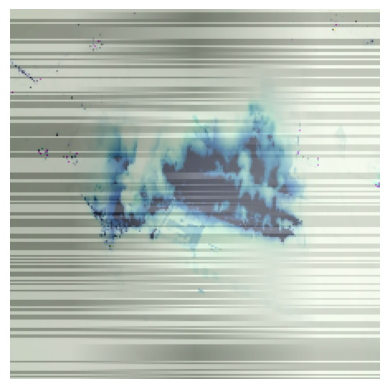

In [61]:
from tensorflow.keras.applications.vgg16 import preprocess_input
from tf_explain.core.grad_cam import GradCAM

# Load the VGG16 model
model_VGG16 = load_model("model_VGG16_8r5eqnu.h5")

# Function to compute Grad-CAM heatmap for a given image path and model
def compute_grad_cam(image_path, model):
    img = tf.keras.preprocessing.image.load_img(image_path, target_size=(224, 224))
    img_array = tf.keras.preprocessing.image.img_to_array(img)
    img_array = preprocess_input(img_array)
    img_array = np.expand_dims(img_array, axis=0)

    # Create a GradCAM explainer
    explainer = GradCAM()

    # Compute Grad-CAM heatmap for the 'fire' class (assuming index 1)
    grid = explainer.explain((img_array, None), model, class_index=1)

    return grid[0]  # Select the heatmap for the first image in the batch

# Example usage for one image
image_path = "test/fire/F_2062.jpg"
heatmap_VGG16 = compute_grad_cam(image_path, model_VGG16)

# Load the original image
original_image = tf.keras.preprocessing.image.load_img(image_path, target_size=(224, 224))
original_image = tf.keras.preprocessing.image.img_to_array(original_image)

# Rescale the heatmap to match the original image size
heatmap_rescaled = cv2.resize(heatmap_VGG16, (224, 224))

# Normalize the heatmap to values between 0 and 1
heatmap_rescaled = heatmap_rescaled - np.min(heatmap_rescaled)
heatmap_rescaled = heatmap_rescaled / np.max(heatmap_rescaled)

# Convert the heatmap to a 3-channel format
heatmap_rescaled = np.expand_dims(heatmap_rescaled, axis=-1)
heatmap_rescaled = np.tile(heatmap_rescaled, [1, 1, 3])

# Overlay the heatmap on the original image
alpha = 0.5  # Set transparency of heatmap overlay
final_image = cv2.addWeighted(np.uint8(255 * original_image), alpha, np.uint8(255 * heatmap_rescaled), 1 - alpha, 0)

# Visualize the overlay
plt.imshow(final_image)
plt.axis('off')
plt.show()


1/1 [==============================] - 1s 891ms/step
Class Name : fire --- Class Probability: 96.32%
Class Name : fire --- Class Probability: 1.11%
Class Name : fire --- Class Probability: 2.58%
1/1 [==============================] - 0s 68ms/step
Class Name : fire --- Class Probability: 84.74%
Class Name : fire --- Class Probability: 14.75%
Class Name : fire --- Class Probability: 0.51%
1/1 [==============================] - 0s 66ms/step
Class Name : fire --- Class Probability: 95.23%
Class Name : fire --- Class Probability: 3.97%
Class Name : fire --- Class Probability: 0.80%
1/1 [==============================] - 0s 60ms/step
Class Name : fire --- Class Probability: 74.08%
Class Name : fire --- Class Probability: 9.41%
Class Name : fire --- Class Probability: 16.51%
1/1 [==============================] - 0s 57ms/step
Class Name : fire --- Class Probability: 95.64%
Class Name : fire --- Class Probability: 2.15%
Class Name : fire --- Class Probability: 2.21%
1/1 [======================

<Figure size 640x480 with 0 Axes>

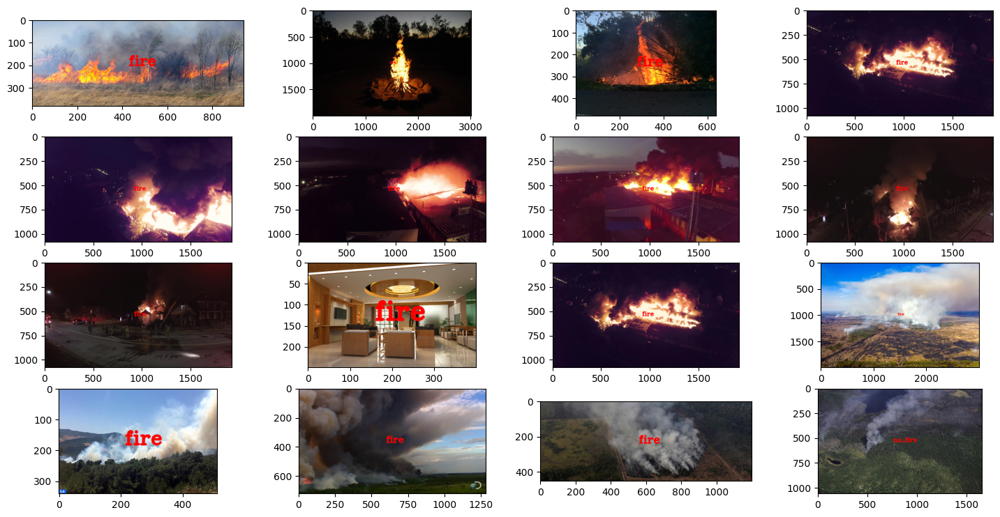

In [21]:
from PIL import Image
%matplotlib inline

axes=[]
fig = plt.figure()
fig = plt.figure(figsize=(18,9))

classes = test_ds.class_names
liste_image = images_to_test
compteur = 1
for image_path in liste_image:
    # predict VGG16
    img = Image.open(image_path).convert('RGB')
    x = tf.keras.utils.img_to_array(img,data_format='channels_last')
    x = tf.keras.preprocessing.image.smart_resize(x, size=(299,299))
    x = np.expand_dims(x, axis=0)
    pred = model_VGG16.predict(x,batch_size=1)[0]


    for (pos,prob) in enumerate(pred):
            class_name = classes[pos]
            if (pos == np.argmax(pred)) :
                img = cv2.imread(image_path)
                img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                font = cv2.FONT_HERSHEY_COMPLEX
                textsize = cv2.getTextSize(class_name, font, 1, 2)[0]
                textX = (img.shape[1] - textsize[0]) / 2
                textY = (img.shape[0] + textsize[1]) / 2
                cv2.putText(img, class_name, (int(textX)-10, int(textY)), font, 2, (255,0,0), 6, cv2.LINE_AA)
                axes.append(fig.add_subplot(4, 4, compteur))
                plt.imshow(img)
                compteur += 1
            # print("Top %d ====================" % (i + 1))
            print("Class Name : %s" % (classes[np.argmax(pred)]), "---", "Class Probability: %.2f%%" % (prob*100))

plt.show()

test/fire/test002.jpg
1/1 [==============================] - 1s 806ms/step
[0.851118   0.04508971 0.10379227]


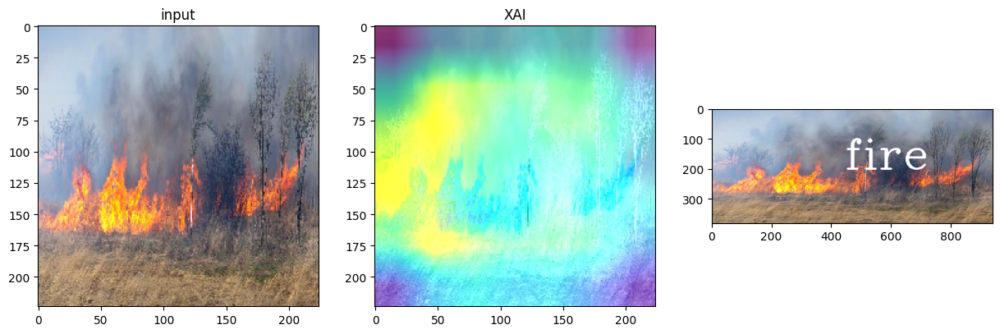

test/fire/test005.jpg
1/1 [==============================] - 0s 53ms/step
[0.20219828 0.77143466 0.0263671 ]


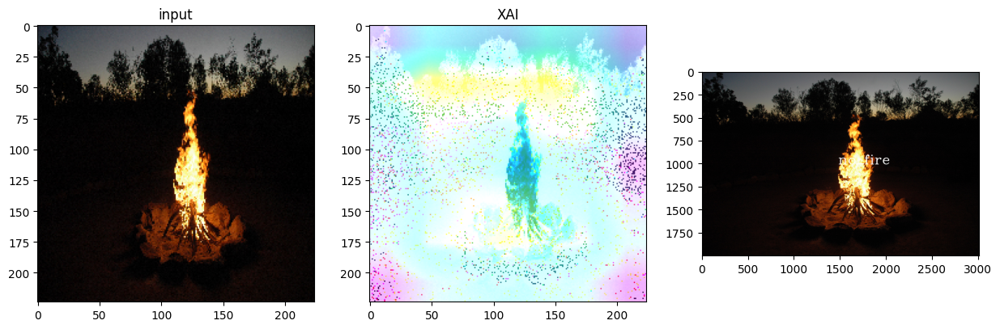

test/fire/test013.jpg
1/1 [==============================] - 0s 46ms/step
[0.21992853 0.6866249  0.0934466 ]


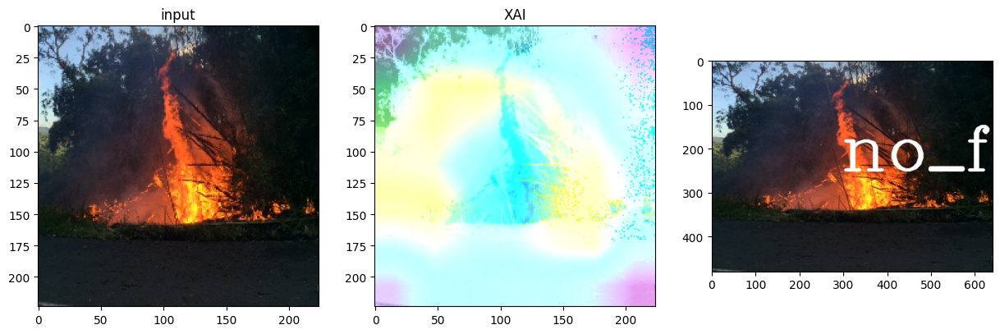

test/fire/F_2062.jpg
1/1 [==============================] - 0s 65ms/step
[0.07172702 0.58988065 0.33839235]


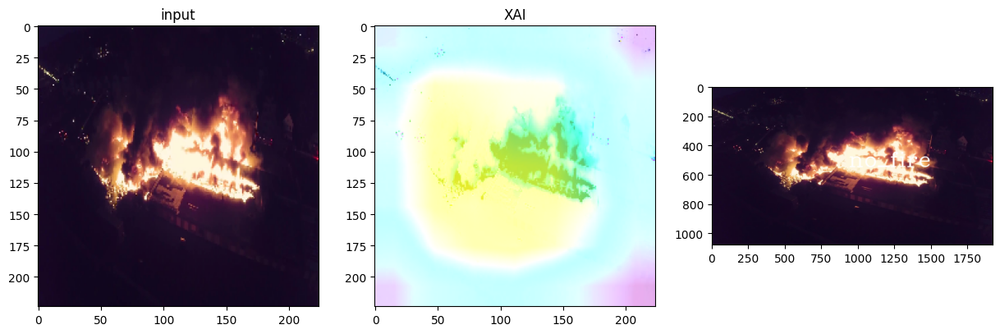

test/fire/F_2063.jpg
1/1 [==============================] - 0s 67ms/step
[0.6908532  0.0437945  0.26535234]


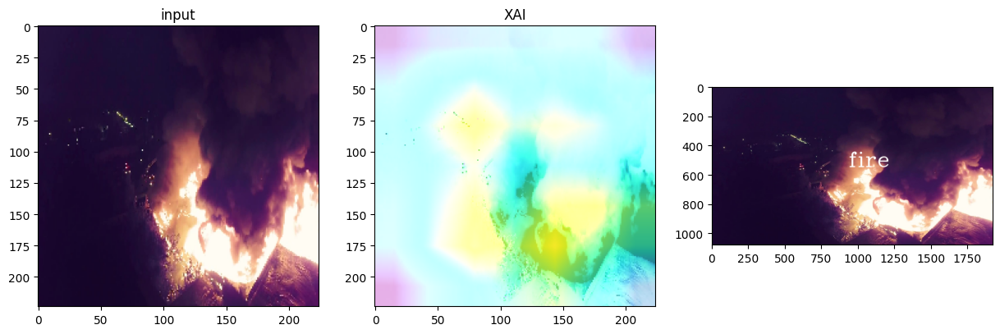

test/fire/F_2064.jpg
1/1 [==============================] - 0s 48ms/step
[0.9915481  0.00646031 0.0019916 ]


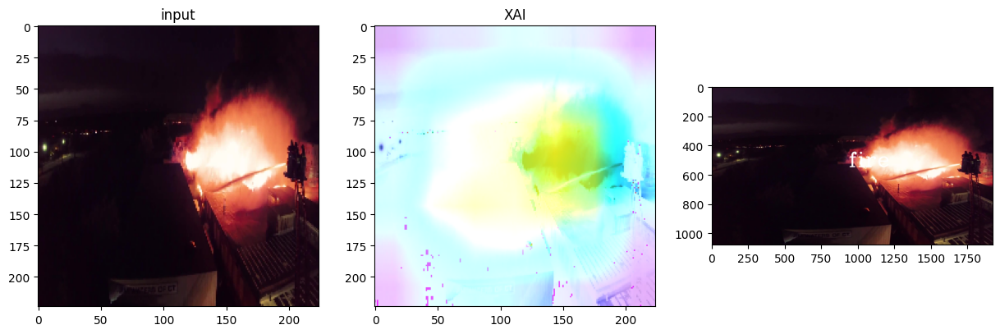

test/fire/F_2066.jpg
1/1 [==============================] - 0s 49ms/step
[0.9900511  0.00684543 0.00310346]


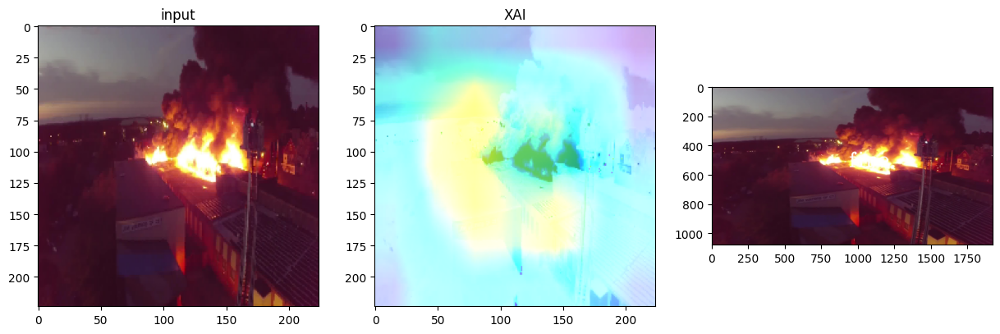

test/fire/F_2067.jpg
1/1 [==============================] - 0s 49ms/step
[0.98957914 0.00394993 0.00647094]


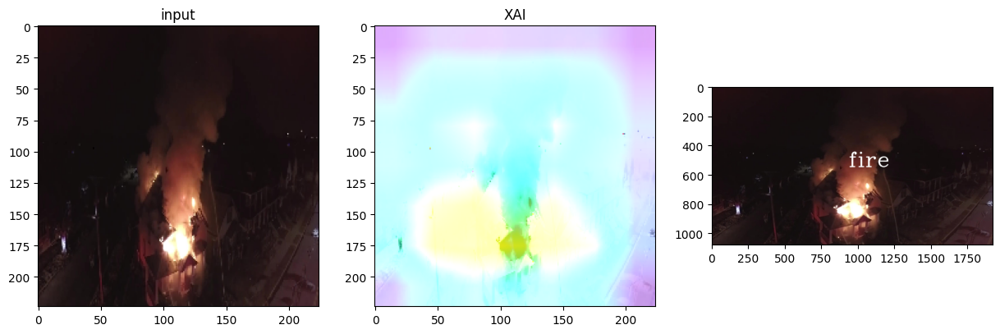

test/fire/F_2080.jpg
1/1 [==============================] - 0s 45ms/step
[0.99129266 0.00688009 0.00182729]


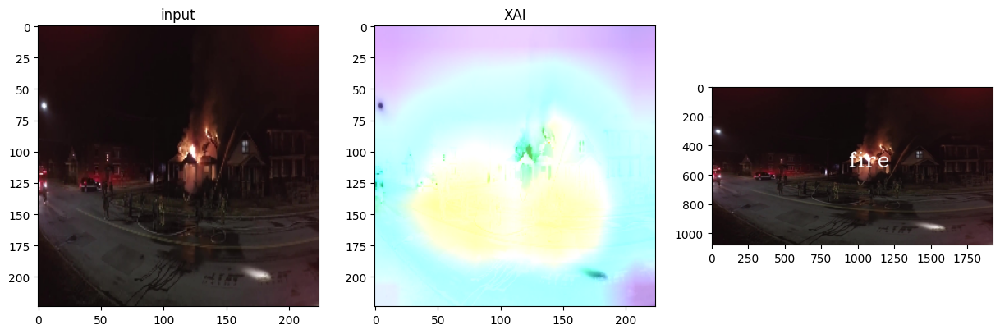

test/no_fire/img31.jpg
1/1 [==============================] - 0s 45ms/step
[0.1021726  0.78664577 0.11118163]


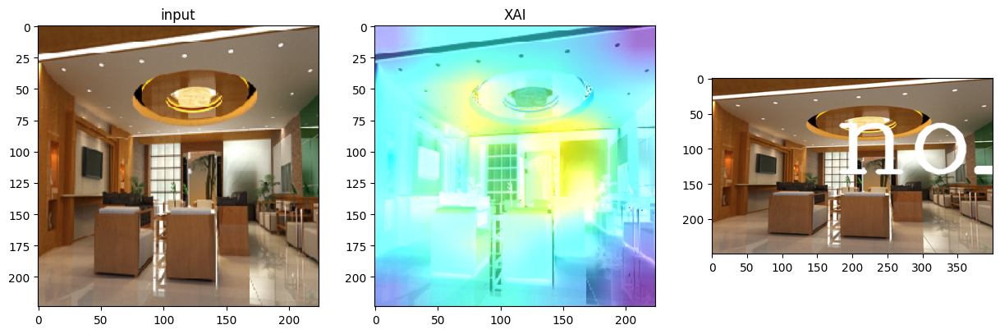

test/fire/F_2062.jpg
1/1 [==============================] - 0s 74ms/step
[0.07172702 0.58988065 0.33839235]


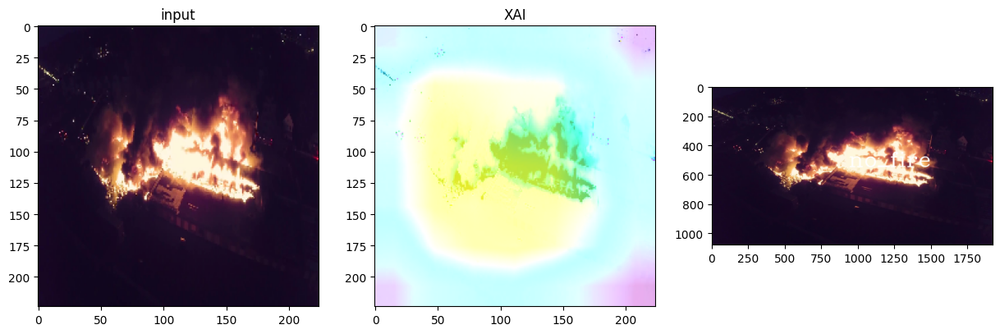

test/start_fire/test101.jpg
1/1 [==============================] - 0s 74ms/step
[0.9857209  0.00289591 0.01138316]


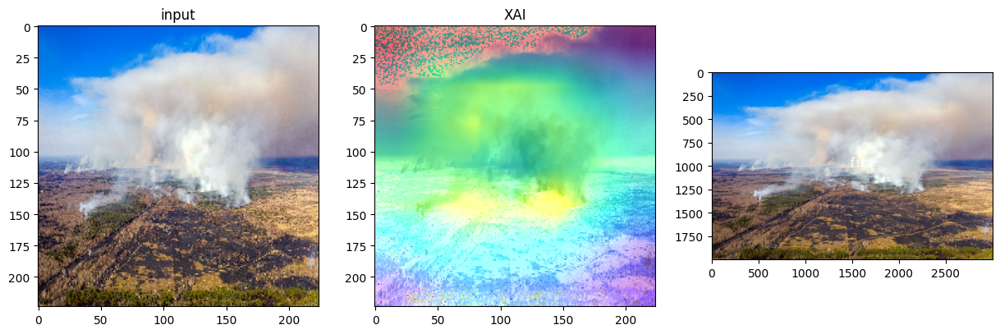

test/start_fire/test122.jpg
1/1 [==============================] - 0s 45ms/step
[0.9907925  0.00196237 0.00724509]


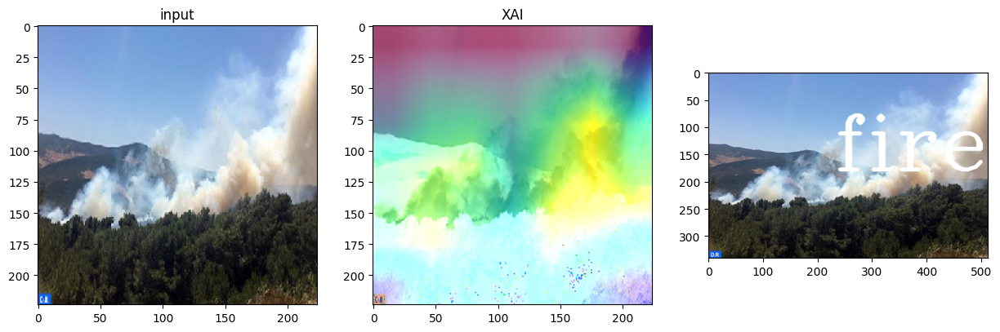

test/start_fire/NorthAmerica (79).png
1/1 [==============================] - 0s 49ms/step
[0.9176917  0.02908381 0.0532244 ]


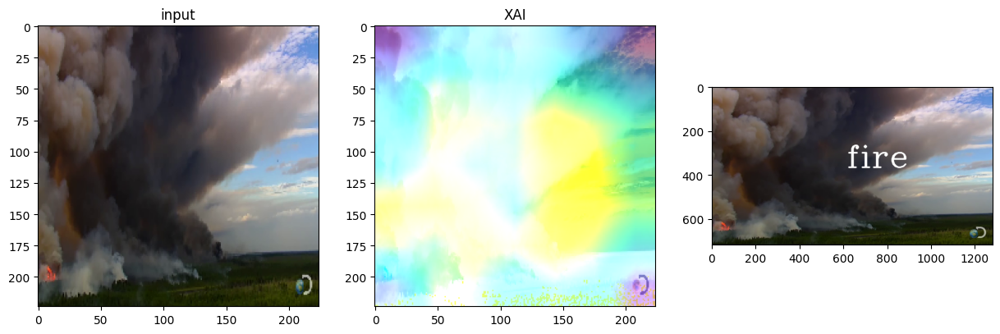

test/start_fire/test106.jpg
1/1 [==============================] - 0s 48ms/step
[0.97622526 0.00605596 0.01771883]


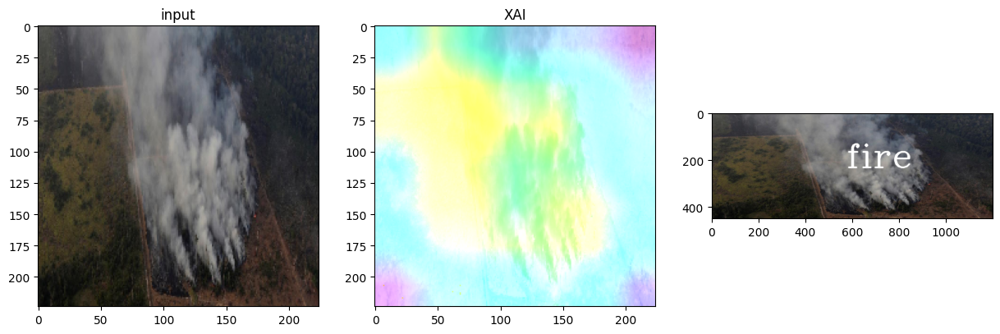

test/start_fire/test118.jpg
1/1 [==============================] - 0s 44ms/step
[0.15900503 0.8356672  0.00532774]


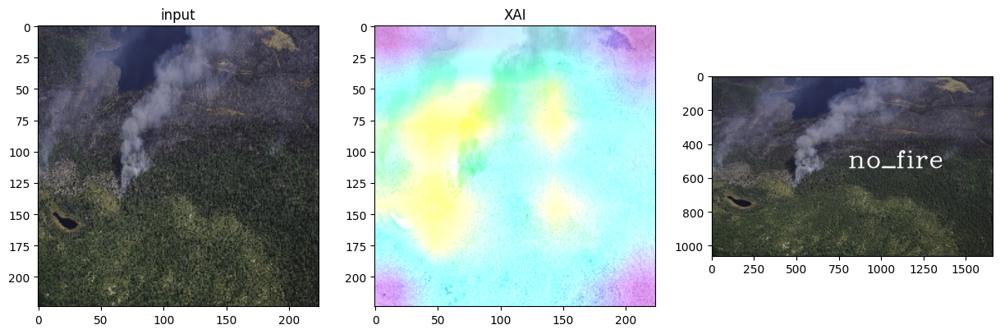

In [22]:
for image_path in images_to_test:
    #imnum=[]
    print(image_path)
    # Load to the correct format and predict the current image
    img0 = tf.keras.preprocessing.image.load_img(image_path, target_size=(input_dim,input_dim))
    img = tf.keras.preprocessing.image.img_to_array(img0)

    data = ([img], None)
    xy=np.expand_dims(img,axis=0)
    myTuple=(xy,None)

    # Start explainer
    #explainer = SmoothGrad()
    explainer = GradCAM()
    grid = explainer.explain(myTuple, model, class_index=1)
    temp = np.concatenate((img,grid),axis=1)
    fig, axs = plt.subplots(1, 3)
    axs[0].imshow(img.astype(np.uint8))
    axs[0].set_title("input")
    axs[1].imshow(grid.astype(np.uint8))
    axs[1].set_title("XAI")

    fig.set_figheight(15)
    fig.set_figwidth(15)


    pred = model.predict(xy,batch_size=1)[0]
    print(pred)
    for (pos,prob) in enumerate(pred):
      pos == np.argmax(pred)
      img = cv2.imread(image_path)
      img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
      font = cv2.FONT_HERSHEY_COMPLEX
      textsize = cv2.getTextSize(className, font, 0.7, 2)[0]
      textX = (img.shape[1] - textsize[0]) / 2
      textY = (img.shape[0] + textsize[1]) / 2
      cv2.putText(img, classes[np.argmax(pred)], (int(textX), int(textY)), font, 4.7, (255,255,255), 5, cv2.LINE_AA)
      axs[2].imshow(img)
    plt.show()

test/fire/test002.jpg
1/1 [==============================] - 1s 1s/step
[0.851118   0.04508971 0.10379227]


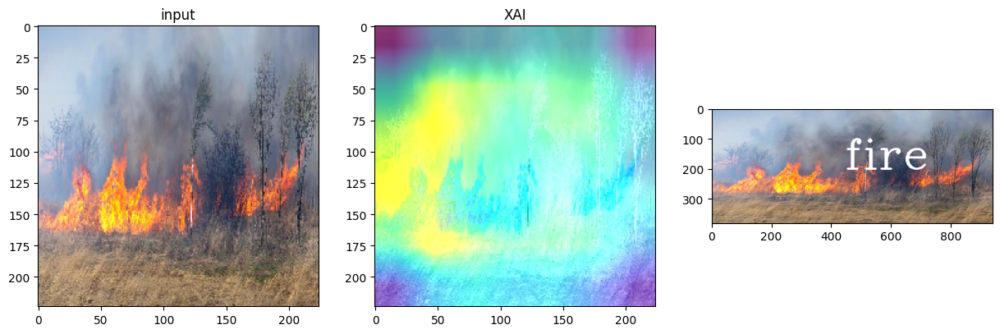

test/fire/test005.jpg
1/1 [==============================] - 0s 68ms/step
[0.20219828 0.77143466 0.0263671 ]


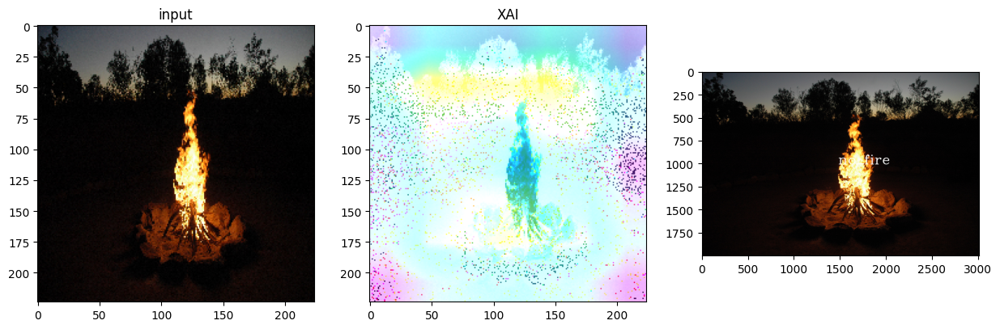

test/fire/test013.jpg
1/1 [==============================] - 0s 44ms/step
[0.21992853 0.6866249  0.0934466 ]


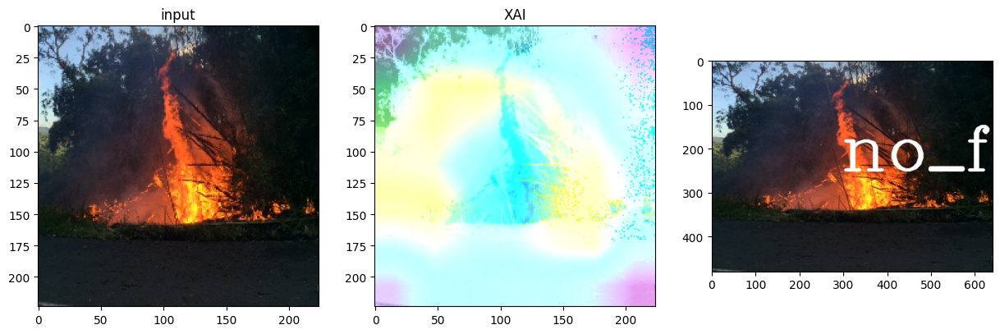

test/fire/F_2062.jpg
1/1 [==============================] - 0s 56ms/step
[0.07172702 0.58988065 0.33839235]


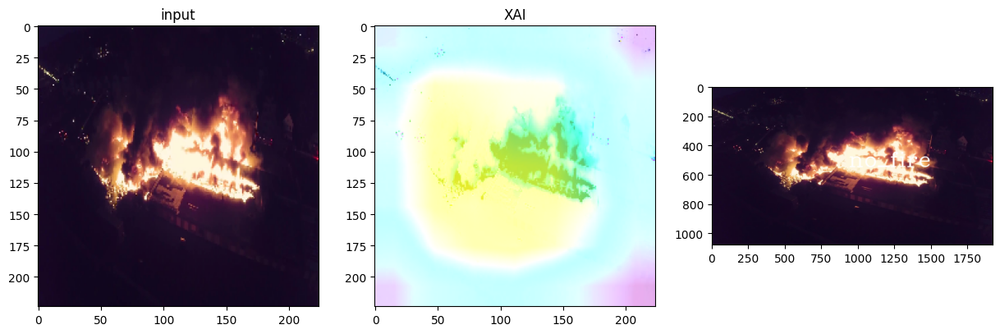

test/fire/F_2063.jpg
1/1 [==============================] - 0s 46ms/step
[0.6908532  0.0437945  0.26535234]


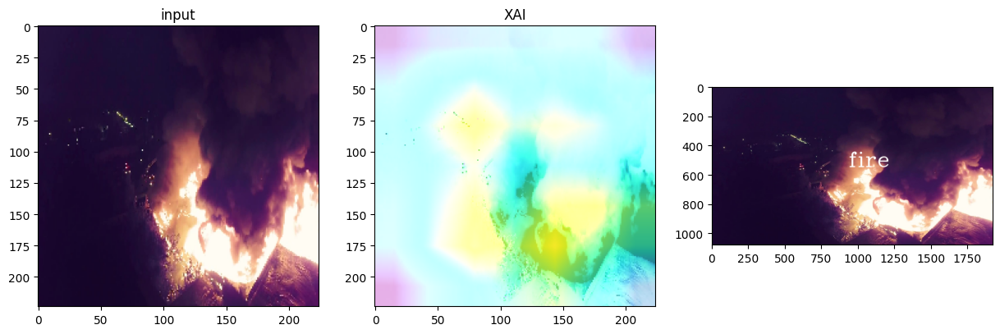

test/fire/F_2064.jpg
1/1 [==============================] - 0s 45ms/step
[0.9915481  0.00646031 0.0019916 ]


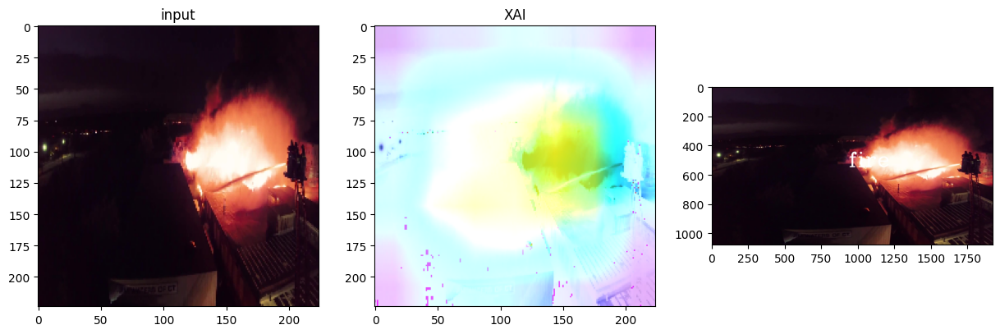

test/fire/F_2066.jpg
1/1 [==============================] - 0s 45ms/step
[0.9900511  0.00684543 0.00310346]


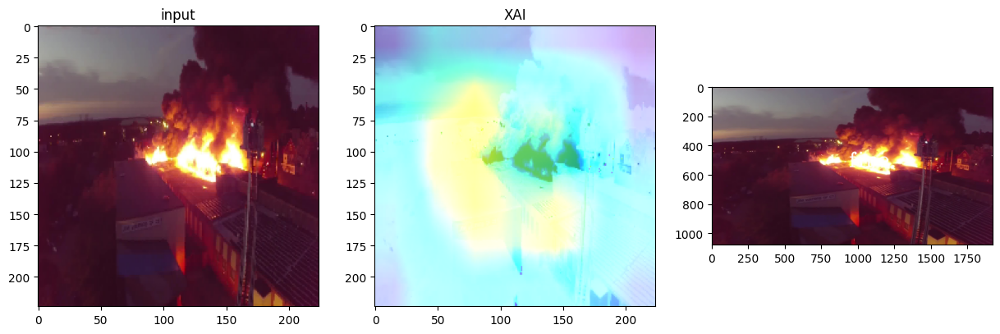

test/fire/F_2067.jpg
1/1 [==============================] - 0s 66ms/step
[0.98957914 0.00394993 0.00647094]


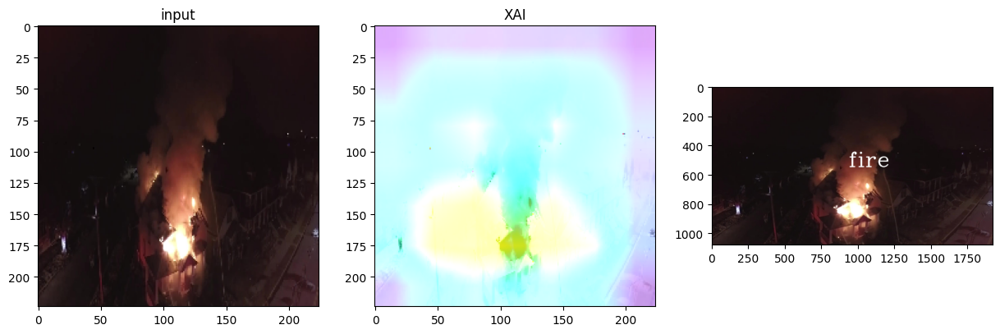

test/fire/F_2080.jpg
1/1 [==============================] - 0s 46ms/step
[0.99129266 0.00688009 0.00182729]


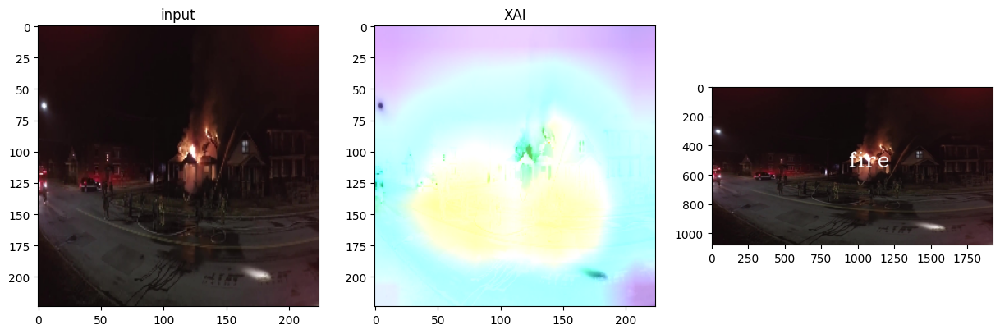

test/no_fire/img31.jpg
1/1 [==============================] - 0s 47ms/step
[0.1021726  0.78664577 0.11118163]


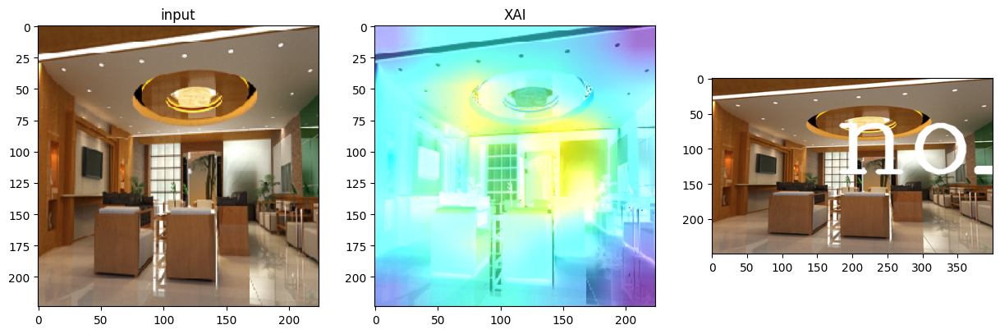

test/fire/F_2062.jpg
1/1 [==============================] - 0s 49ms/step
[0.07172702 0.58988065 0.33839235]


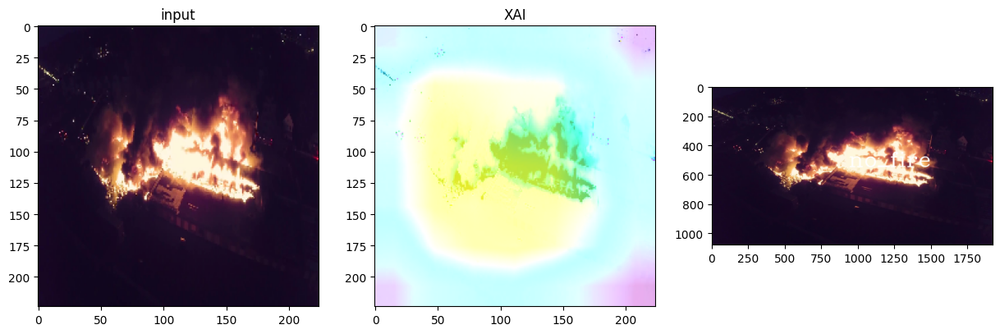

test/start_fire/test101.jpg
1/1 [==============================] - 0s 54ms/step
[0.9857209  0.00289591 0.01138316]


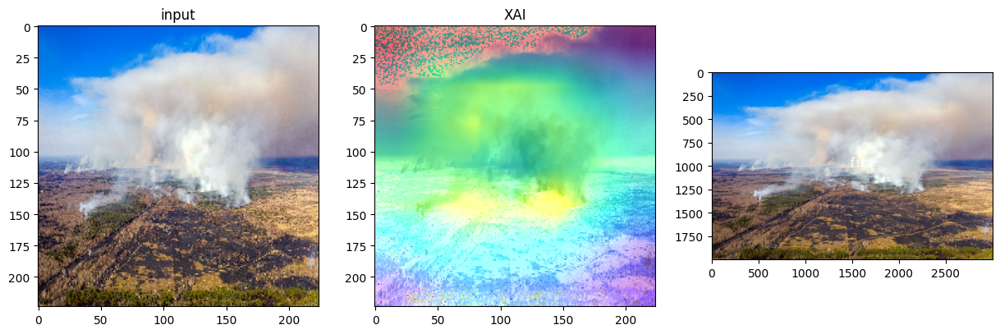

test/start_fire/test122.jpg
1/1 [==============================] - 0s 70ms/step
[0.9907925  0.00196237 0.00724509]


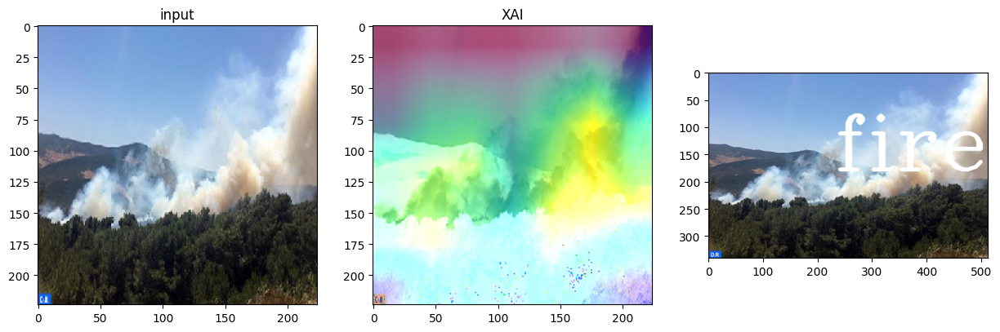

test/start_fire/NorthAmerica (79).png
1/1 [==============================] - 0s 73ms/step
[0.9176917  0.02908381 0.0532244 ]


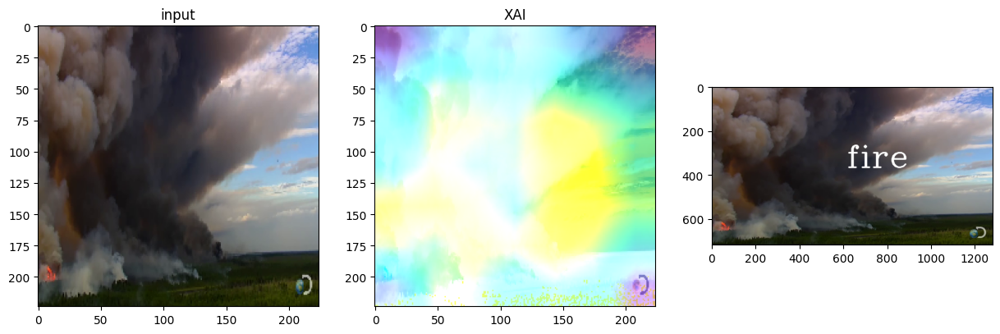

test/start_fire/test106.jpg
1/1 [==============================] - 0s 77ms/step
[0.97622526 0.00605596 0.01771883]


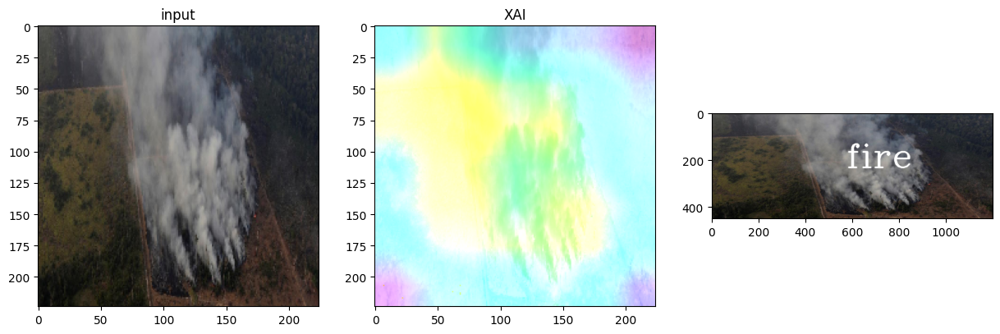

test/start_fire/test118.jpg
1/1 [==============================] - 0s 60ms/step
[0.15900503 0.8356672  0.00532774]


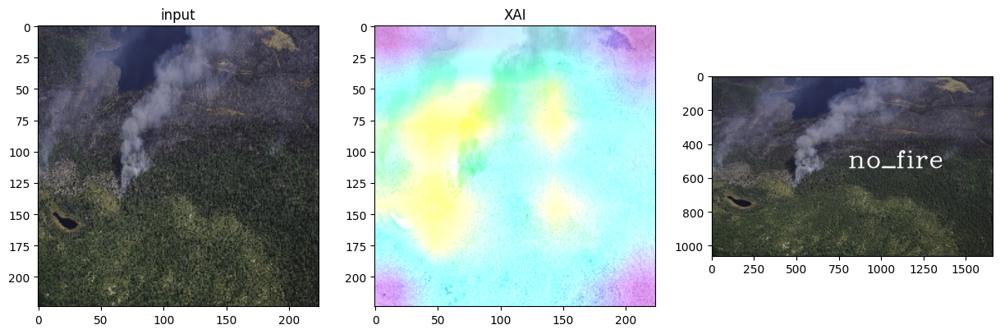

In [23]:
for image_path in images_to_test:
    #imnum=[]
    print(image_path)
    # Load to the correct format and predict the current image
    img0 = tf.keras.preprocessing.image.load_img(image_path, target_size=(input_dim,input_dim))
    img = tf.keras.preprocessing.image.img_to_array(img0)

    data = ([img], None)
    xy=np.expand_dims(img,axis=0)
    myTuple=(xy,None)

    # Start explainer
    #explainer = SmoothGrad()
    explainer = GradCAM()
    grid = explainer.explain(myTuple, model_VGG19, class_index=1)
    temp = np.concatenate((img,grid),axis=1)
    fig, axs = plt.subplots(1, 3)
    axs[0].imshow(img.astype(np.uint8))
    axs[0].set_title("input")
    axs[1].imshow(grid.astype(np.uint8))
    axs[1].set_title("XAI")

    fig.set_figheight(15)
    fig.set_figwidth(15)


    pred_VGG19 = model_VGG19.predict(xy,batch_size=1)[0]
    print(pred_VGG19)
    for (pos,prob) in enumerate(pred_VGG19):
      pos == np.argmax(pred_VGG19)
      img = cv2.imread(image_path)
      img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
      font = cv2.FONT_HERSHEY_COMPLEX
      textsize = cv2.getTextSize(className, font, 0.7, 2)[0]
      textX = (img.shape[1] - textsize[0]) / 2
      textY = (img.shape[0] + textsize[1]) / 2
      cv2.putText(img, classes[np.argmax(pred_VGG19)], (int(textX), int(textY)), font, 4.7, (255,255,255), 5, cv2.LINE_AA)
      axs[2].imshow(img)
    plt.show()

test/fire/test002.jpg
1/1 [==============================] - 1s 823ms/step
[0.851118   0.04508971 0.10379227]


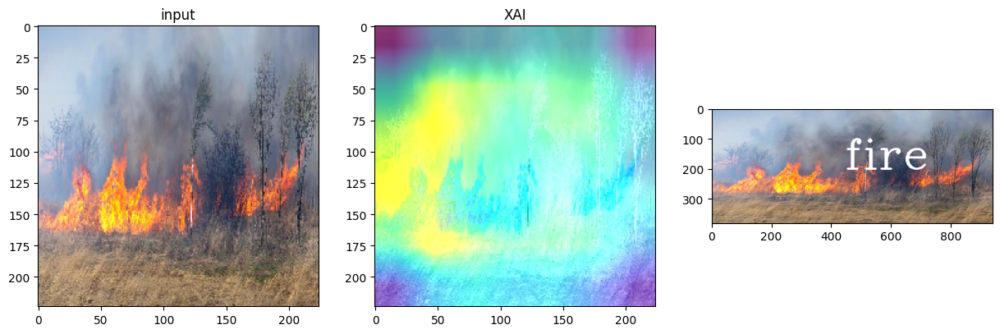

test/fire/test005.jpg
1/1 [==============================] - 0s 45ms/step
[0.20219828 0.77143466 0.0263671 ]


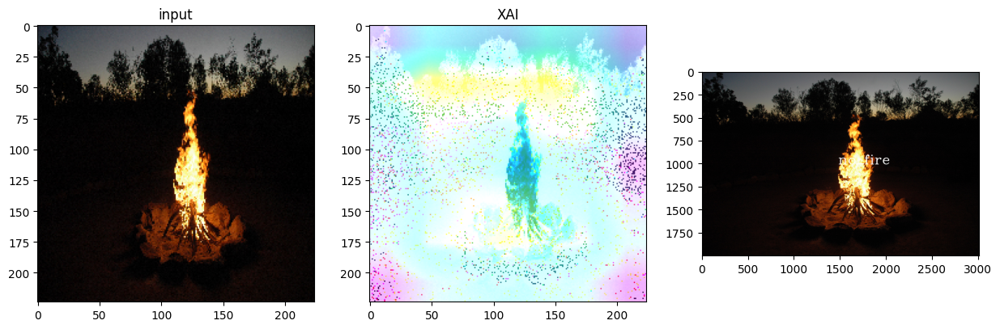

test/fire/test013.jpg
1/1 [==============================] - 0s 46ms/step
[0.21992853 0.6866249  0.0934466 ]


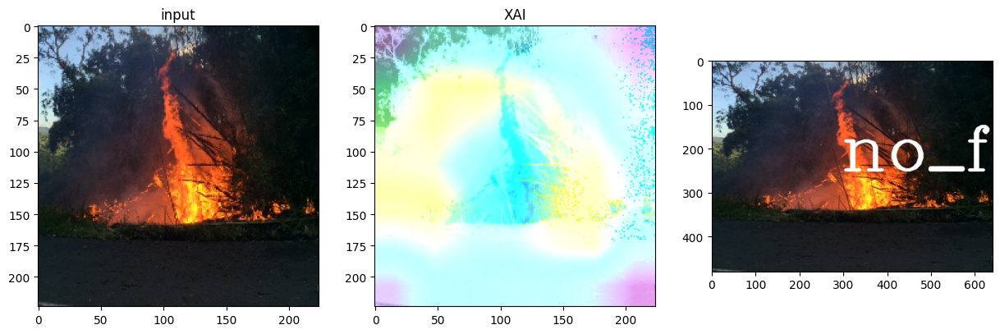

test/fire/F_2062.jpg
1/1 [==============================] - 0s 45ms/step
[0.07172702 0.58988065 0.33839235]


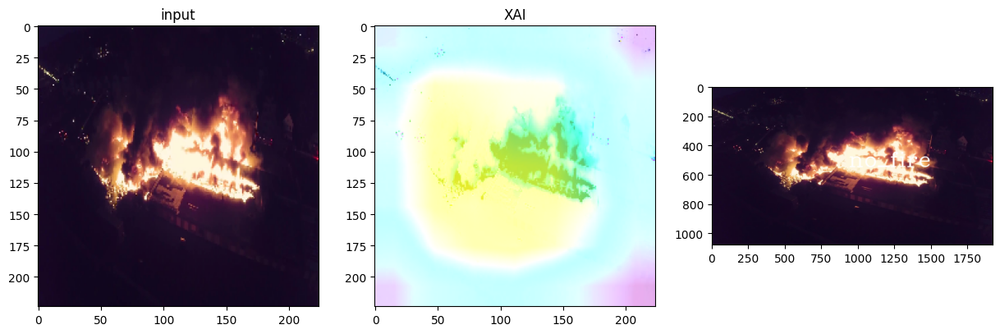

test/fire/F_2063.jpg
1/1 [==============================] - 0s 70ms/step
[0.6908532  0.0437945  0.26535234]


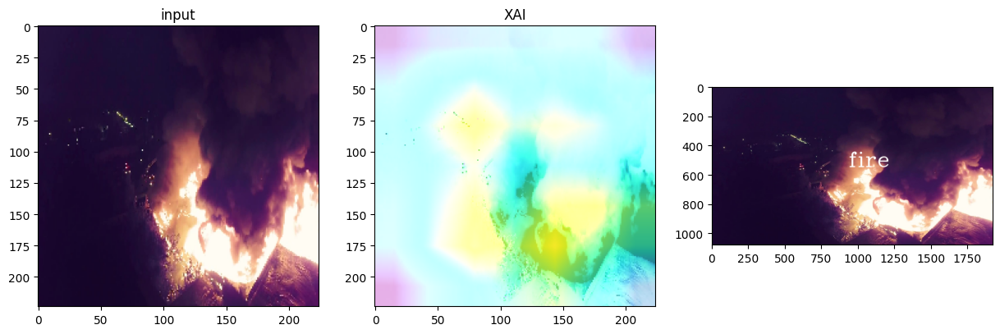

test/fire/F_2064.jpg
1/1 [==============================] - 0s 45ms/step
[0.9915481  0.00646031 0.0019916 ]


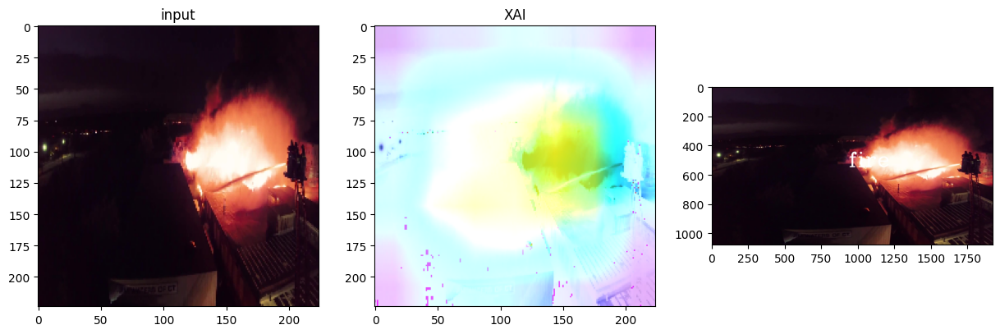

test/fire/F_2066.jpg
1/1 [==============================] - 0s 47ms/step
[0.9900511  0.00684543 0.00310346]


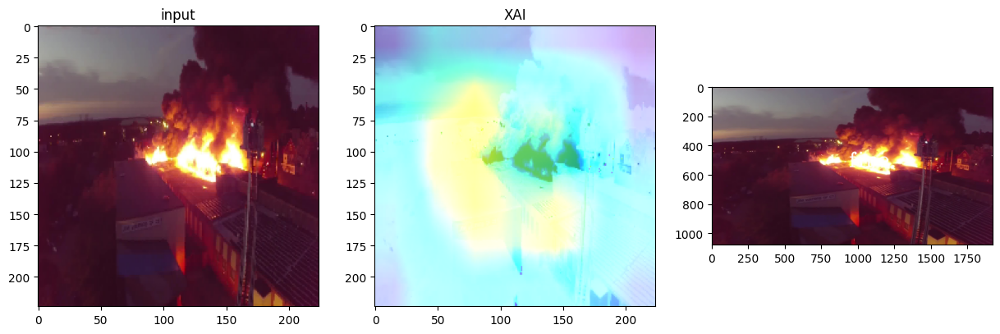

test/fire/F_2067.jpg
1/1 [==============================] - 0s 54ms/step
[0.98957914 0.00394993 0.00647094]


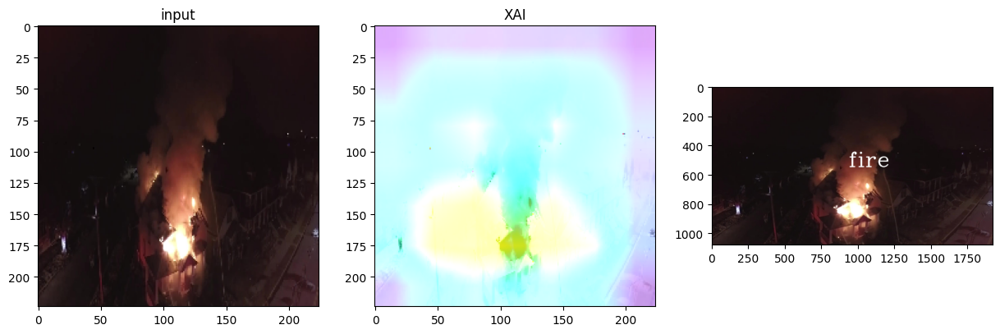

test/fire/F_2080.jpg
1/1 [==============================] - 0s 53ms/step
[0.99129266 0.00688009 0.00182729]


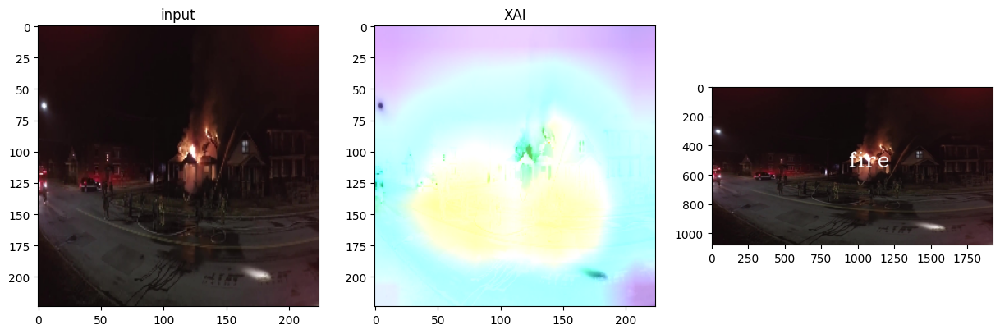

test/no_fire/img31.jpg
1/1 [==============================] - 0s 50ms/step
[0.1021726  0.78664577 0.11118163]


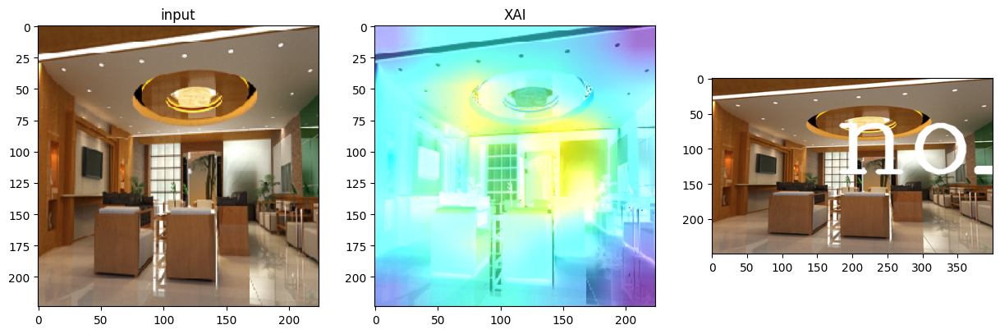

test/fire/F_2062.jpg
1/1 [==============================] - 0s 46ms/step
[0.07172702 0.58988065 0.33839235]


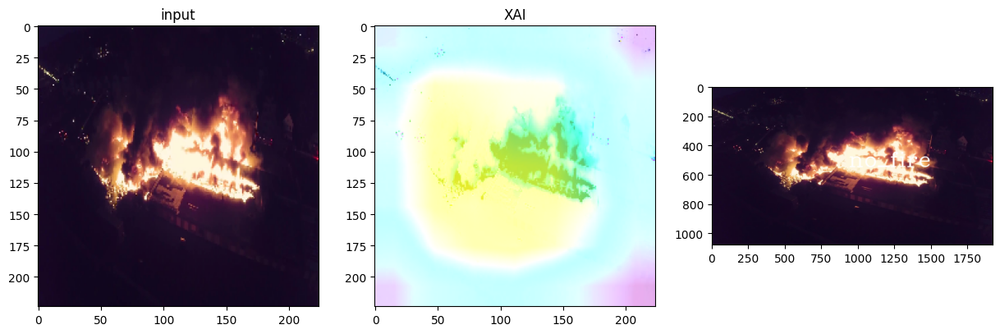

test/start_fire/test101.jpg
1/1 [==============================] - 0s 72ms/step
[0.9857209  0.00289591 0.01138316]


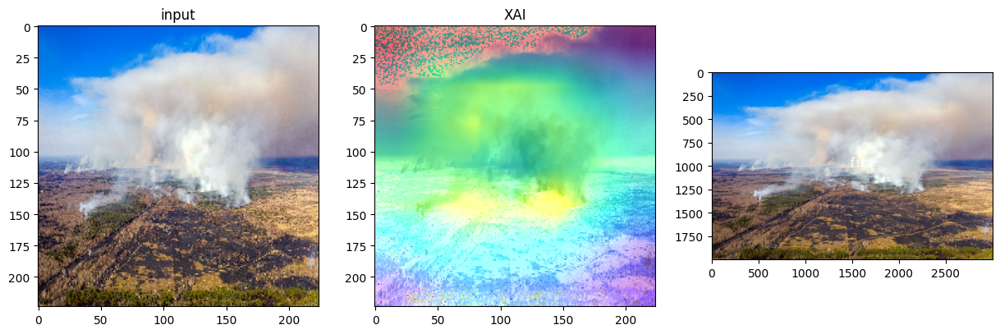

test/start_fire/test122.jpg
1/1 [==============================] - 0s 46ms/step
[0.9907925  0.00196237 0.00724509]


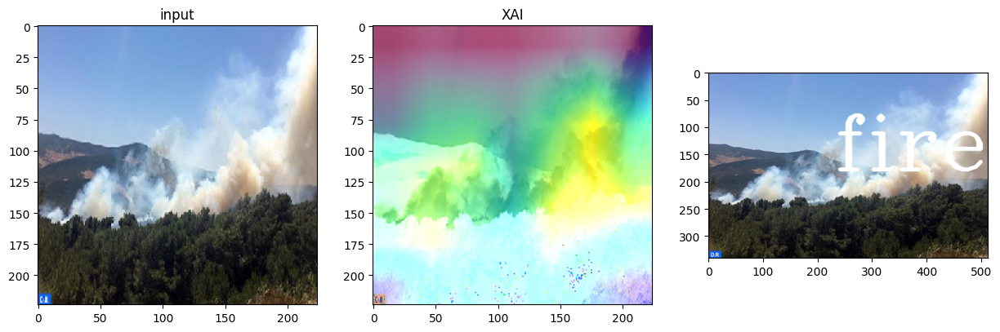

test/start_fire/NorthAmerica (79).png
1/1 [==============================] - 0s 49ms/step
[0.9176917  0.02908381 0.0532244 ]


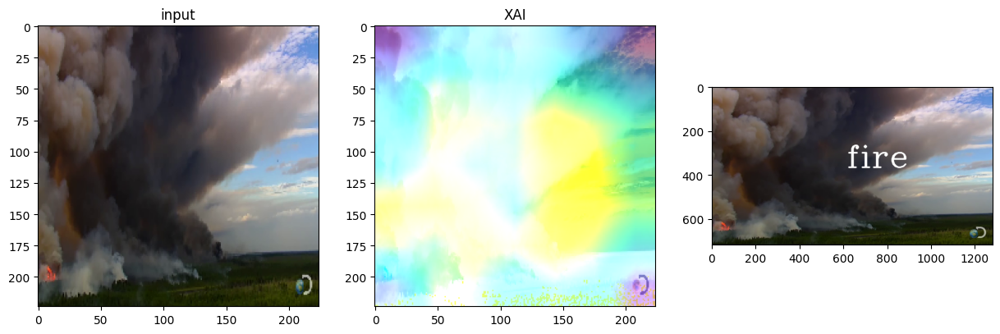

test/start_fire/test106.jpg
1/1 [==============================] - 0s 46ms/step
[0.97622526 0.00605596 0.01771883]


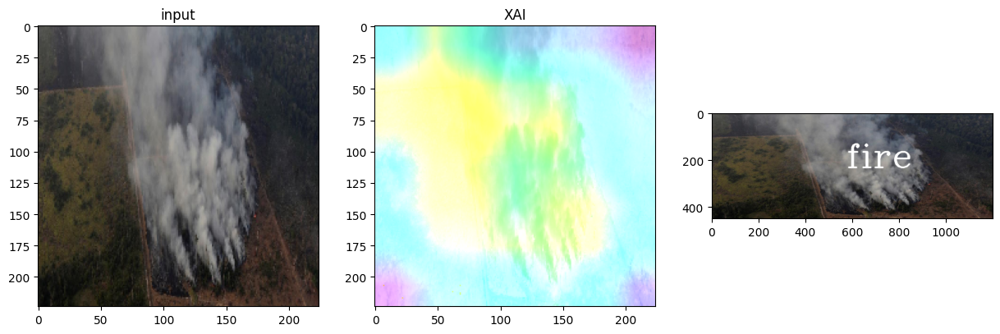

test/start_fire/test118.jpg
1/1 [==============================] - 0s 56ms/step
[0.15900503 0.8356672  0.00532774]


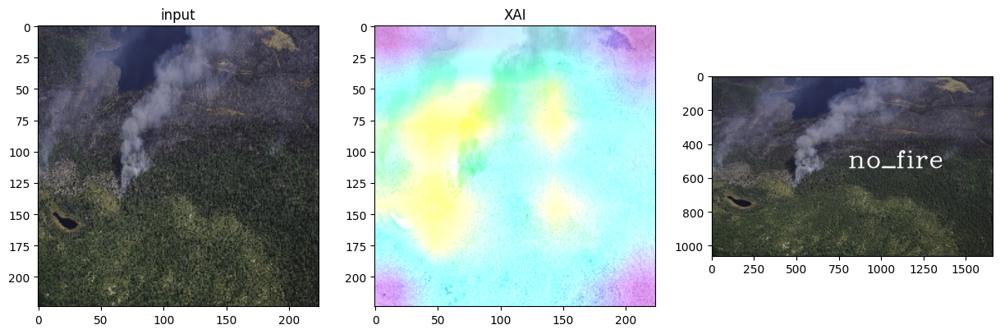

In [24]:
for image_path in images_to_test:
    #imnum=[]
    print(image_path)
    # Load to the correct format and predict the current image
    img0 = tf.keras.preprocessing.image.load_img(image_path, target_size=(input_dim,input_dim))
    img = tf.keras.preprocessing.image.img_to_array(img0)

    data = ([img], None)
    xy=np.expand_dims(img,axis=0)
    myTuple=(xy,None)

    # Start explainer
    #explainer = SmoothGrad()
    explainer = GradCAM()
    grid = explainer.explain(myTuple, model_DsNt121, class_index=1)
    temp = np.concatenate((img,grid),axis=1)
    fig, axs = plt.subplots(1, 3)
    axs[0].imshow(img.astype(np.uint8))
    axs[0].set_title("input")
    axs[1].imshow(grid.astype(np.uint8))
    axs[1].set_title("XAI")

    fig.set_figheight(15)
    fig.set_figwidth(15)


    pred_DsNt121 = model_DsNt121.predict(xy,batch_size=1)[0]
    print(pred_DsNt121)
    for (pos,prob) in enumerate(pred_DsNt121):
      pos == np.argmax(pred_DsNt121)
      img = cv2.imread(image_path)
      img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
      font = cv2.FONT_HERSHEY_COMPLEX
      textsize = cv2.getTextSize(className, font, 0.7, 2)[0]
      textX = (img.shape[1] - textsize[0]) / 2
      textY = (img.shape[0] + textsize[1]) / 2
      cv2.putText(img, classes[np.argmax(pred_DsNt121)], (int(textX), int(textY)), font, 4.7, (255,255,255), 5, cv2.LINE_AA)
      axs[2].imshow(img)
    plt.show()


test/fire/test002.jpg
1/1 [==============================] - 1s 796ms/step
[0.851118   0.04508971 0.10379227]


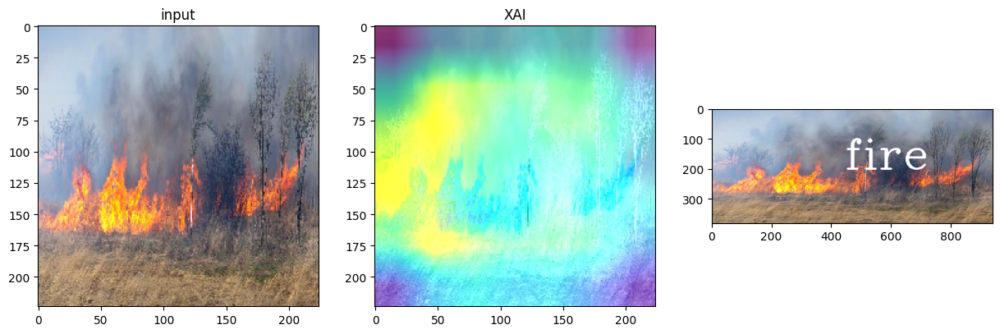

test/fire/test005.jpg
1/1 [==============================] - 0s 70ms/step
[0.20219828 0.77143466 0.0263671 ]


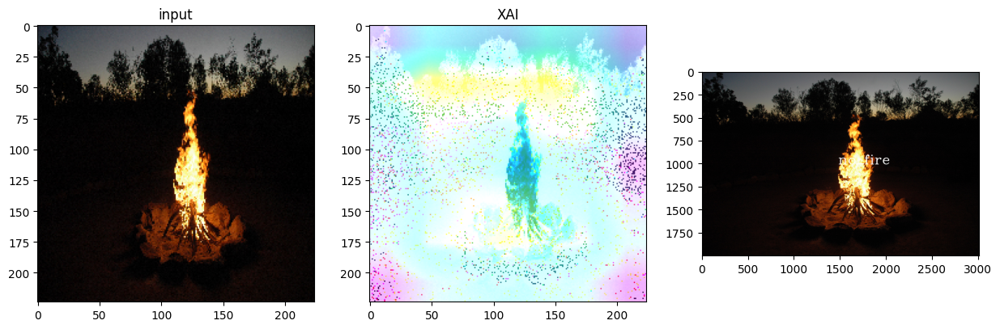

test/fire/test013.jpg
1/1 [==============================] - 0s 47ms/step
[0.21992853 0.6866249  0.0934466 ]


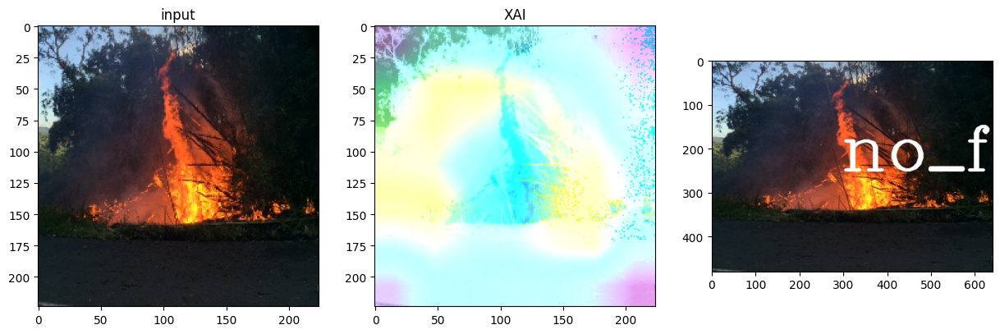

test/fire/F_2062.jpg
1/1 [==============================] - 0s 49ms/step
[0.07172702 0.58988065 0.33839235]


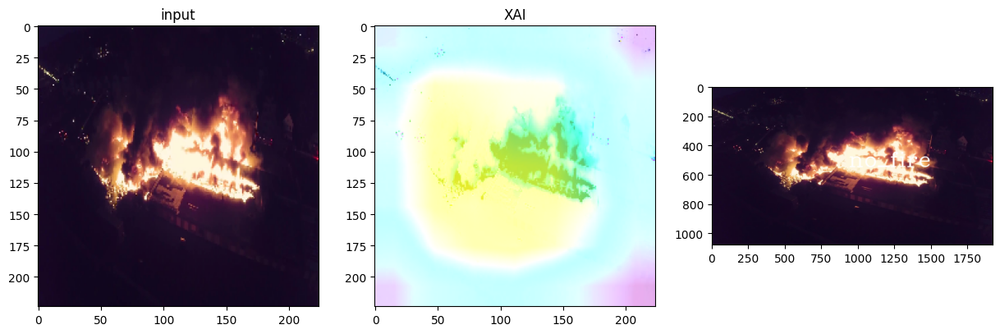

test/fire/F_2063.jpg
1/1 [==============================] - 0s 47ms/step
[0.6908532  0.0437945  0.26535234]


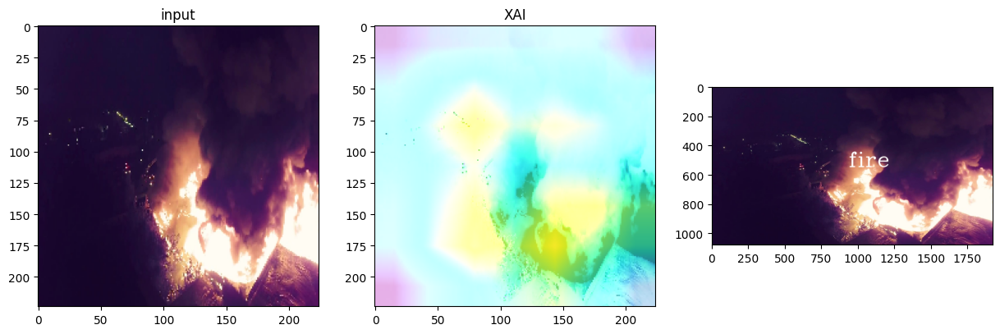

test/fire/F_2064.jpg
1/1 [==============================] - 0s 55ms/step
[0.9915481  0.00646031 0.0019916 ]


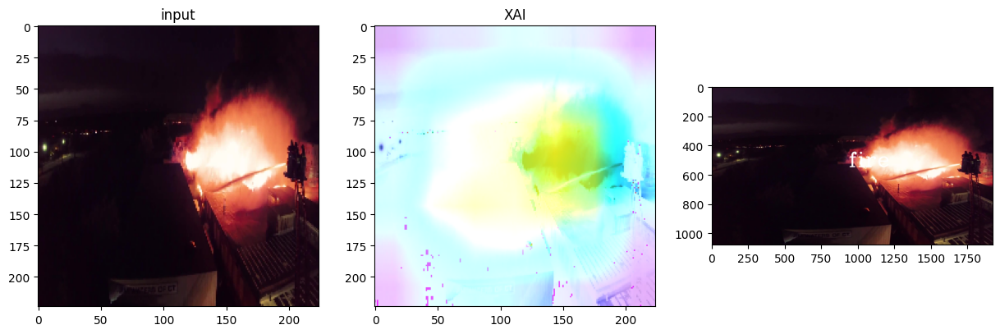

test/fire/F_2066.jpg
1/1 [==============================] - 0s 46ms/step
[0.9900511  0.00684543 0.00310346]


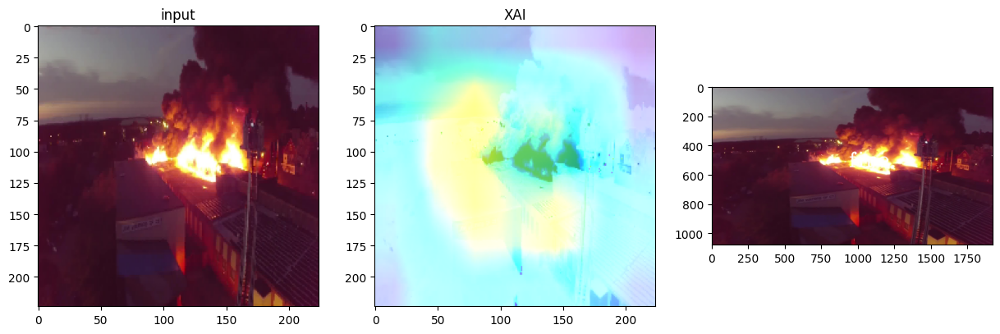

test/fire/F_2067.jpg
1/1 [==============================] - 0s 68ms/step
[0.98957914 0.00394993 0.00647094]


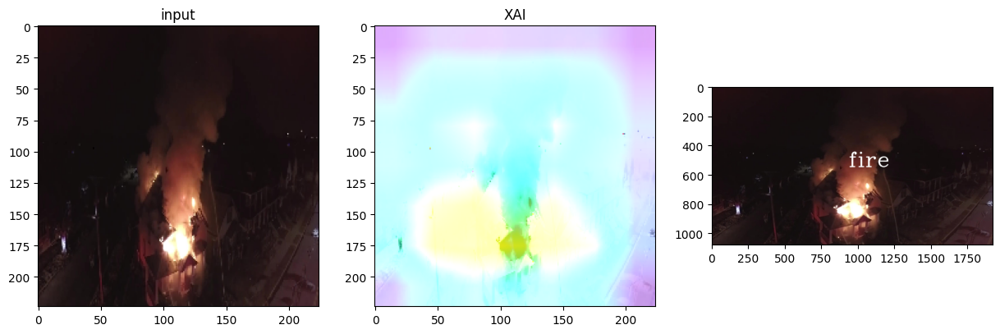

test/fire/F_2080.jpg
1/1 [==============================] - 0s 71ms/step
[0.99129266 0.00688009 0.00182729]


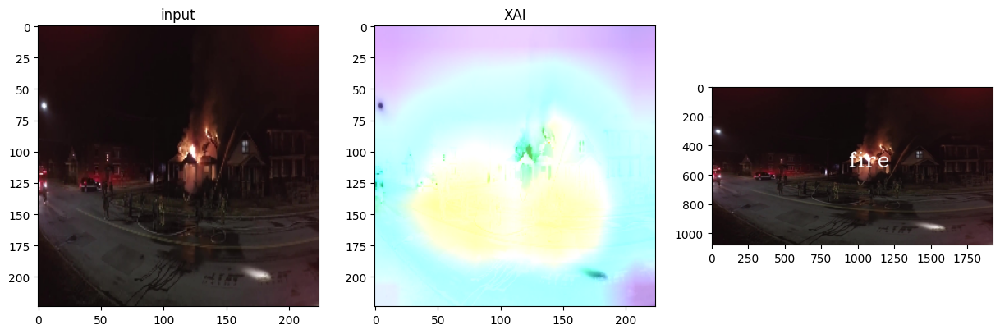

test/no_fire/img31.jpg
1/1 [==============================] - 0s 49ms/step
[0.1021726  0.78664577 0.11118163]


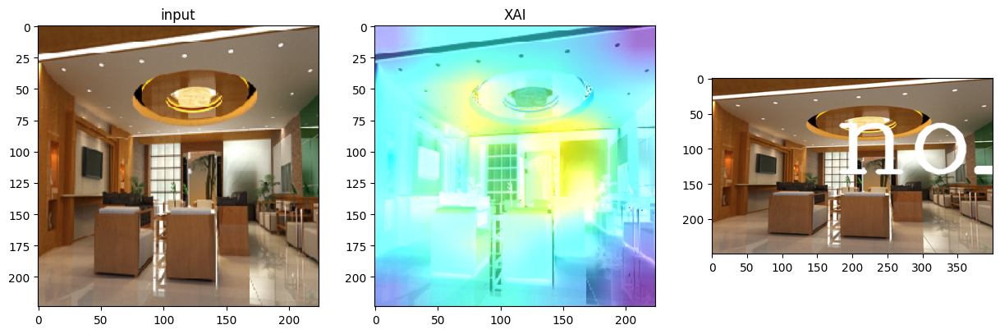

test/fire/F_2062.jpg
1/1 [==============================] - 0s 47ms/step
[0.07172702 0.58988065 0.33839235]


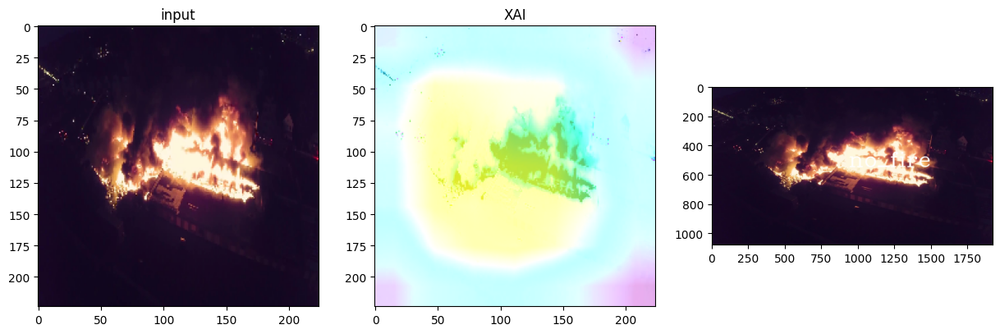

test/start_fire/test101.jpg
1/1 [==============================] - 0s 45ms/step
[0.9857209  0.00289591 0.01138316]


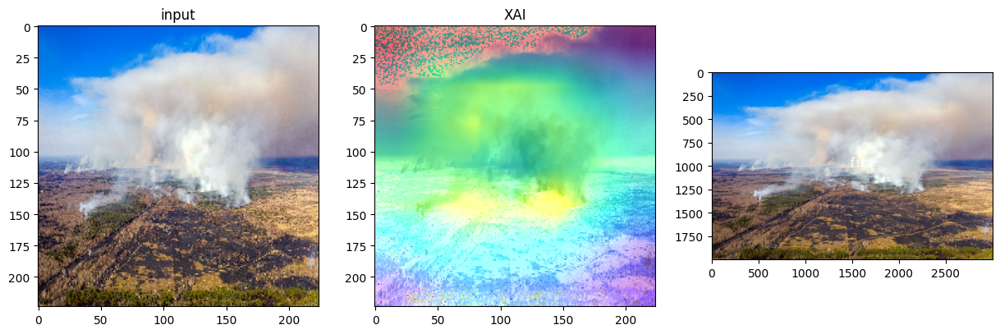

test/start_fire/test122.jpg
1/1 [==============================] - 0s 45ms/step
[0.9907925  0.00196237 0.00724509]


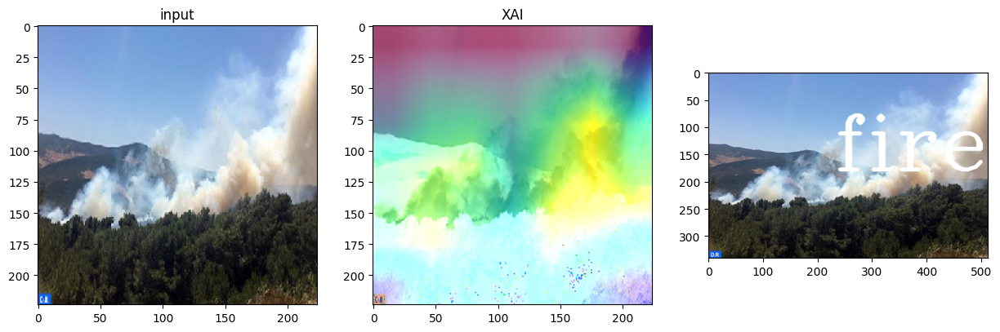

test/start_fire/NorthAmerica (79).png
1/1 [==============================] - 0s 52ms/step
[0.9176917  0.02908381 0.0532244 ]


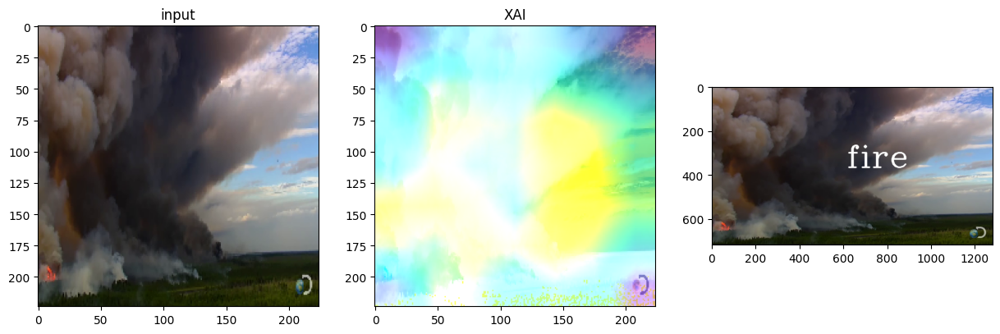

test/start_fire/test106.jpg
1/1 [==============================] - 0s 87ms/step
[0.97622526 0.00605596 0.01771883]


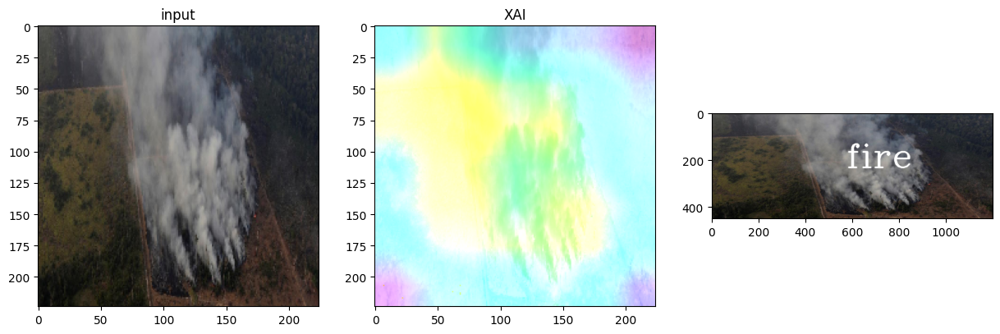

test/start_fire/test118.jpg
1/1 [==============================] - 0s 92ms/step
[0.15900503 0.8356672  0.00532774]


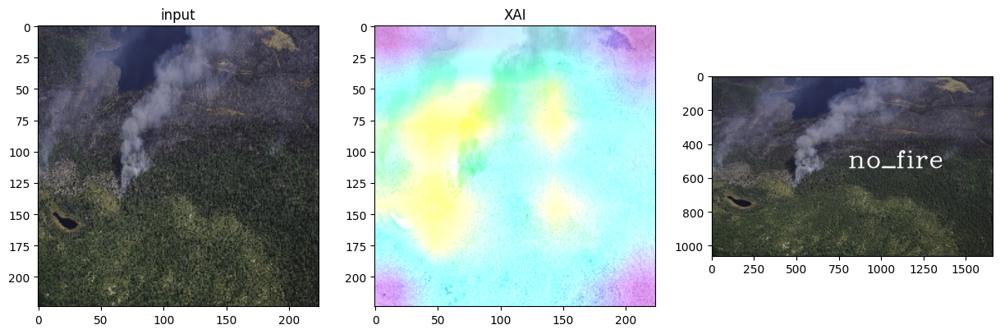

In [25]:
for image_path in images_to_test:
    #imnum=[]
    print(image_path)
    # Load to the correct format and predict the current image
    img0 = tf.keras.preprocessing.image.load_img(image_path, target_size=(input_dim,input_dim))
    img = tf.keras.preprocessing.image.img_to_array(img0)

    data = ([img], None)
    xy=np.expand_dims(img,axis=0)
    myTuple=(xy,None)

    # Start explainer
    #explainer = SmoothGrad()
    explainer = GradCAM()
    grid = explainer.explain(myTuple, model_xception, class_index=1)
    temp = np.concatenate((img,grid),axis=1)
    fig, axs = plt.subplots(1, 3)
    axs[0].imshow(img.astype(np.uint8))
    axs[0].set_title("input")
    axs[1].imshow(grid.astype(np.uint8))
    axs[1].set_title("XAI")

    fig.set_figheight(15)
    fig.set_figwidth(15)


    pred_xception = model_xception.predict(xy,batch_size=1)[0]
    print(pred_xception)
    for (pos,prob) in enumerate(pred_xception):
      pos == np.argmax(pred_xception)
      img = cv2.imread(image_path)
      img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
      font = cv2.FONT_HERSHEY_COMPLEX
      textsize = cv2.getTextSize(className, font, 0.7, 2)[0]
      textX = (img.shape[1] - textsize[0]) / 2
      textY = (img.shape[0] + textsize[1]) / 2
      cv2.putText(img, classes[np.argmax(pred_xception)], (int(textX), int(textY)), font, 4.7, (255,255,255), 5, cv2.LINE_AA)
      axs[2].imshow(img)
    plt.show()

test/fire/test002.jpg
1/1 [==============================] - 1s 820ms/step
[0.851118   0.04508971 0.10379227]


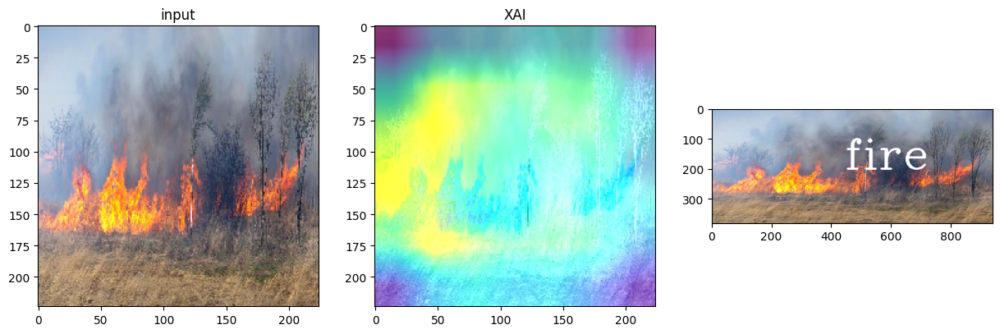

test/fire/test005.jpg
1/1 [==============================] - 0s 53ms/step
[0.20219828 0.77143466 0.0263671 ]


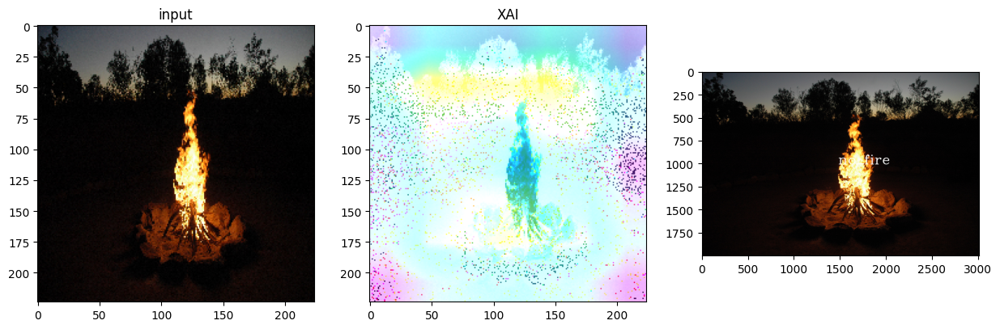

test/fire/test013.jpg
1/1 [==============================] - 0s 46ms/step
[0.21992853 0.6866249  0.0934466 ]


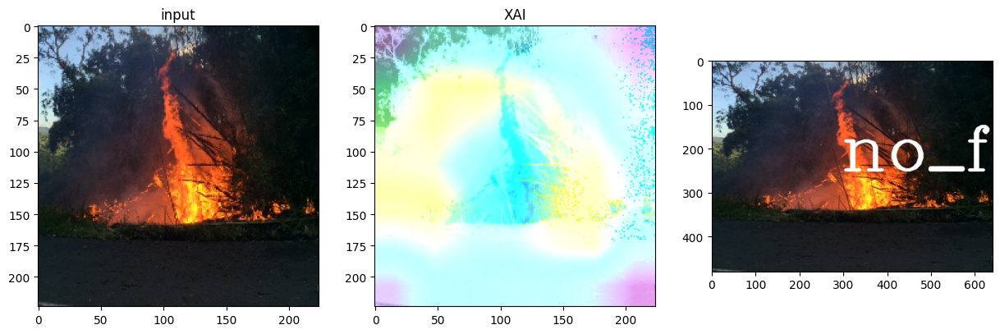

test/fire/F_2062.jpg
1/1 [==============================] - 0s 50ms/step
[0.07172702 0.58988065 0.33839235]


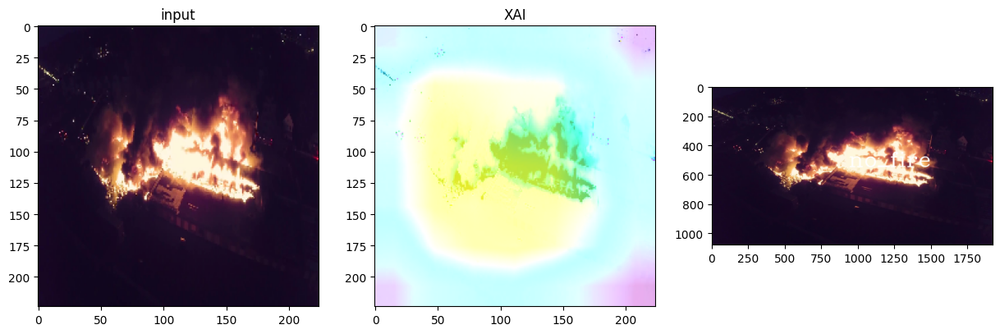

test/fire/F_2063.jpg
1/1 [==============================] - 0s 79ms/step
[0.6908532  0.0437945  0.26535234]


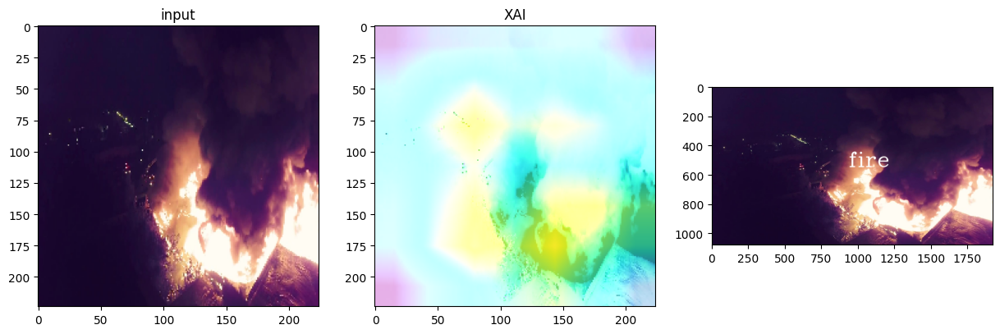

test/fire/F_2064.jpg
1/1 [==============================] - 0s 66ms/step
[0.9915481  0.00646031 0.0019916 ]


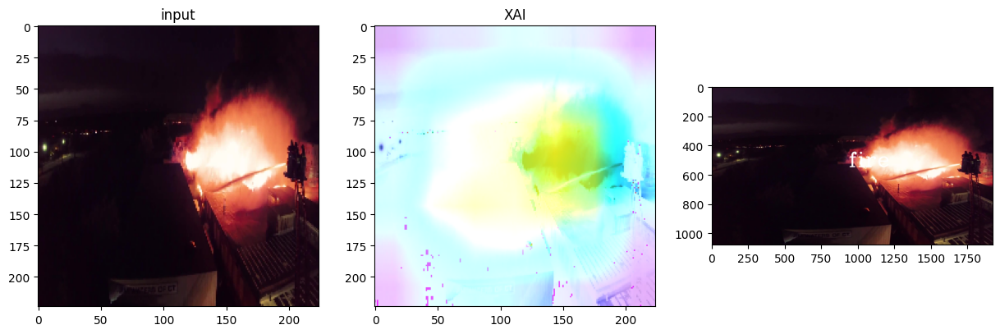

test/fire/F_2066.jpg
1/1 [==============================] - 0s 50ms/step
[0.9900511  0.00684543 0.00310346]


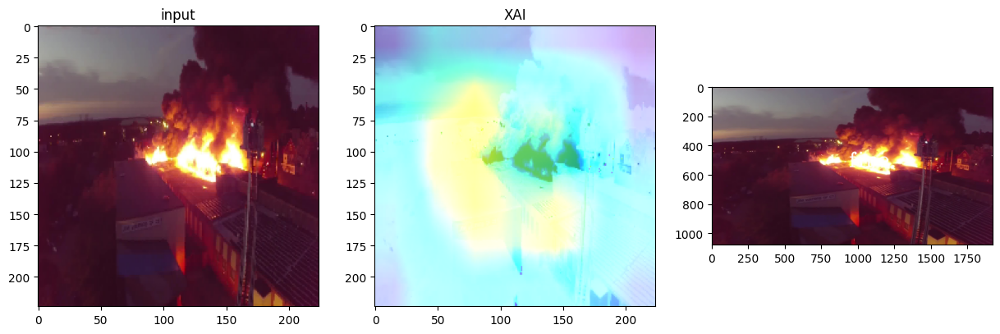

test/fire/F_2067.jpg
1/1 [==============================] - 0s 46ms/step
[0.98957914 0.00394993 0.00647094]


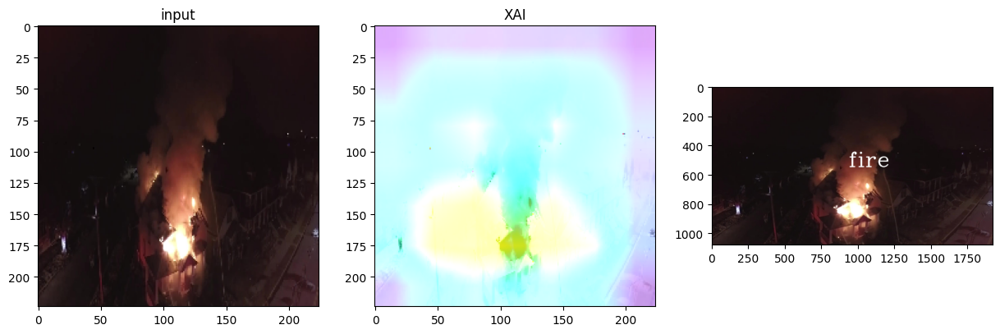

test/fire/F_2080.jpg
1/1 [==============================] - 0s 48ms/step
[0.99129266 0.00688009 0.00182729]


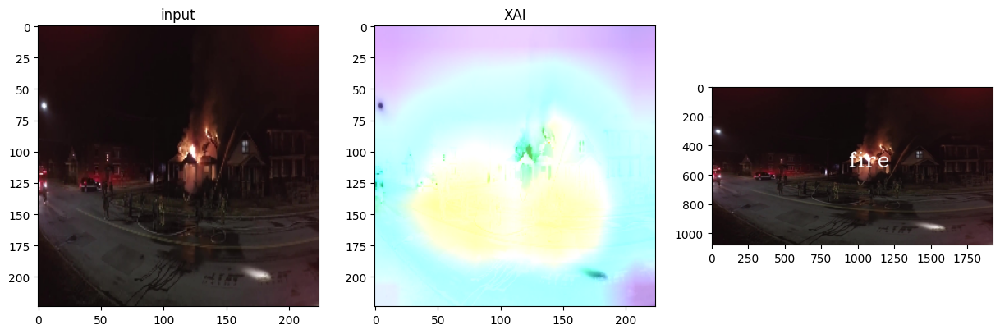

test/no_fire/img31.jpg
1/1 [==============================] - 0s 46ms/step
[0.1021726  0.78664577 0.11118163]


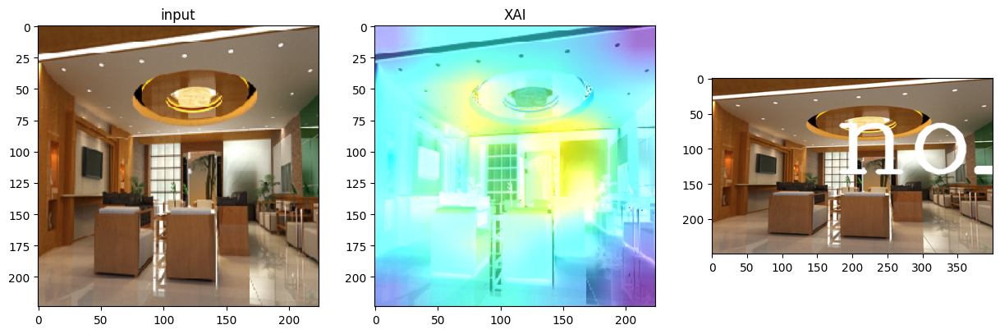

test/fire/F_2062.jpg
1/1 [==============================] - 0s 45ms/step
[0.07172702 0.58988065 0.33839235]


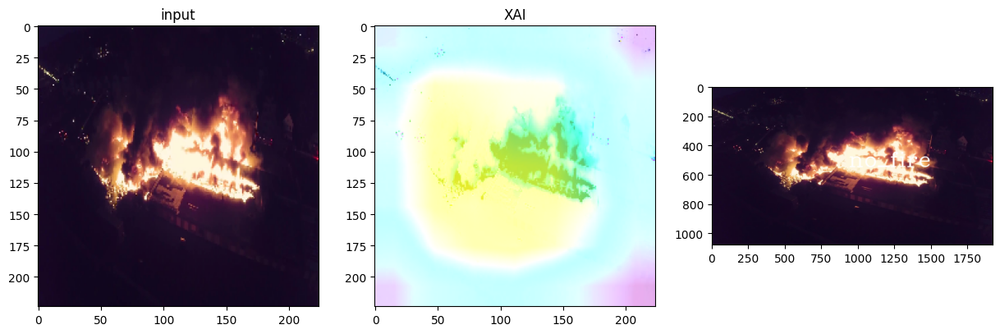

test/start_fire/test101.jpg
1/1 [==============================] - 0s 70ms/step
[0.9857209  0.00289591 0.01138316]


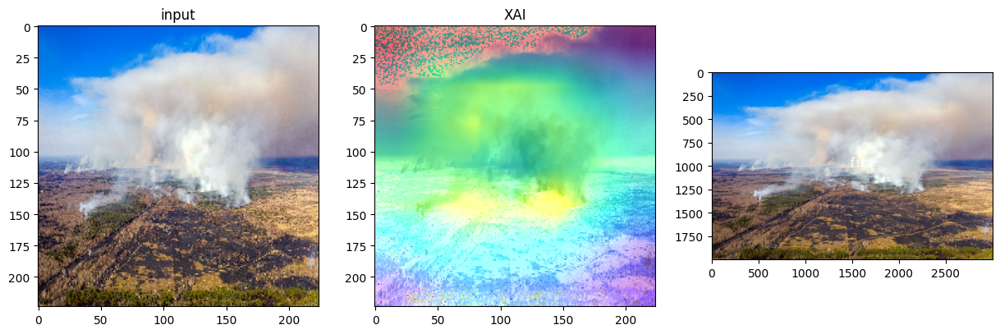

test/start_fire/test122.jpg
1/1 [==============================] - 0s 45ms/step
[0.9907925  0.00196237 0.00724509]


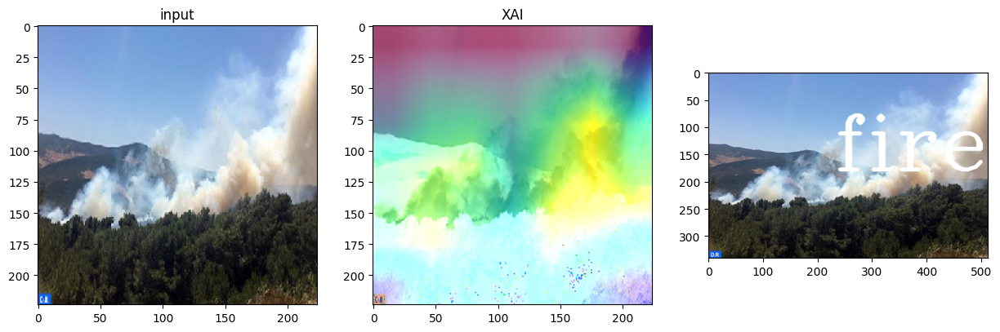

test/start_fire/NorthAmerica (79).png
1/1 [==============================] - 0s 47ms/step
[0.9176917  0.02908381 0.0532244 ]


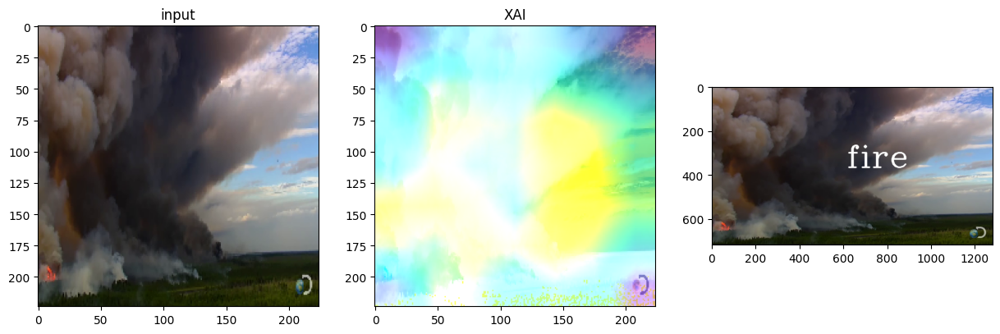

test/start_fire/test106.jpg
1/1 [==============================] - 0s 45ms/step
[0.97622526 0.00605596 0.01771883]


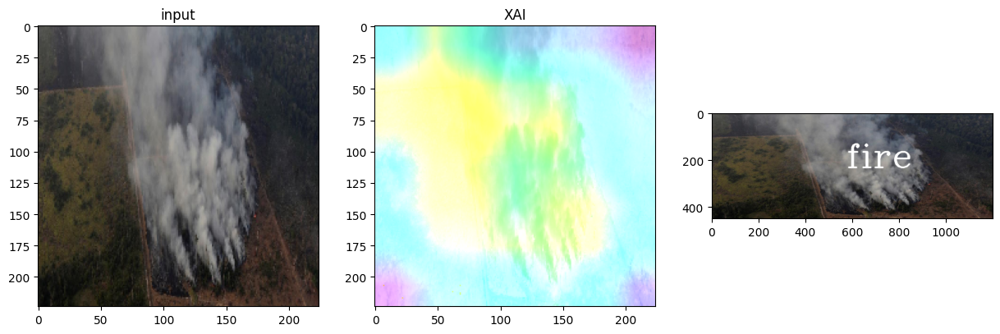

test/start_fire/test118.jpg
1/1 [==============================] - 0s 45ms/step
[0.15900503 0.8356672  0.00532774]


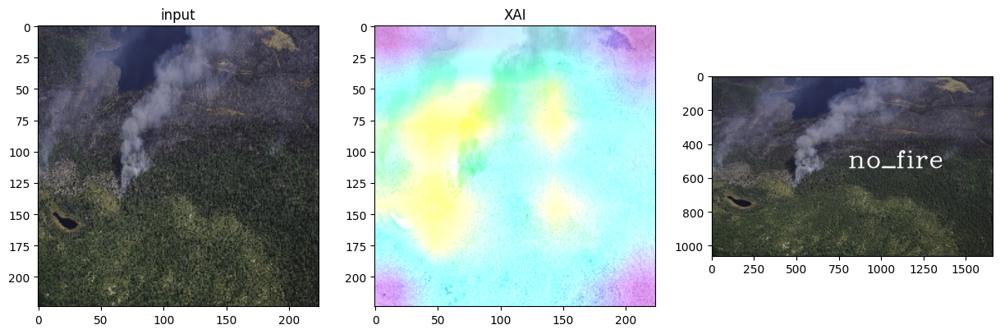

In [26]:
for image_path in images_to_test:
    #imnum=[]
    print(image_path)
    # Load to the correct format and predict the current image
    img0 = tf.keras.preprocessing.image.load_img(image_path, target_size=(input_dim,input_dim))
    img = tf.keras.preprocessing.image.img_to_array(img0)

    data = ([img], None)
    xy=np.expand_dims(img,axis=0)
    myTuple=(xy,None)

    # Start explainer
    #explainer = SmoothGrad()
    explainer = GradCAM()
    grid = explainer.explain(myTuple, model_rsnt50, class_index=1)
    temp = np.concatenate((img,grid),axis=1)
    fig, axs = plt.subplots(1, 3)
    axs[0].imshow(img.astype(np.uint8))
    axs[0].set_title("input")
    axs[1].imshow(grid.astype(np.uint8))
    axs[1].set_title("XAI")

    fig.set_figheight(15)
    fig.set_figwidth(15)


    pred_rsnt50 = model_rsnt50.predict(xy,batch_size=1)[0]
    print(pred_rsnt50)
    for (pos,prob) in enumerate(pred_rsnt50):
      pos == np.argmax(pred_rsnt50)
      img = cv2.imread(image_path)
      img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
      font = cv2.FONT_HERSHEY_COMPLEX
      textsize = cv2.getTextSize(className, font, 0.7, 2)[0]
      textX = (img.shape[1] - textsize[0]) / 2
      textY = (img.shape[0] + textsize[1]) / 2
      cv2.putText(img, classes[np.argmax(pred_rsnt50)], (int(textX), int(textY)), font, 4.7, (255,255,255), 5, cv2.LINE_AA)
      axs[2].imshow(img)
    plt.show()


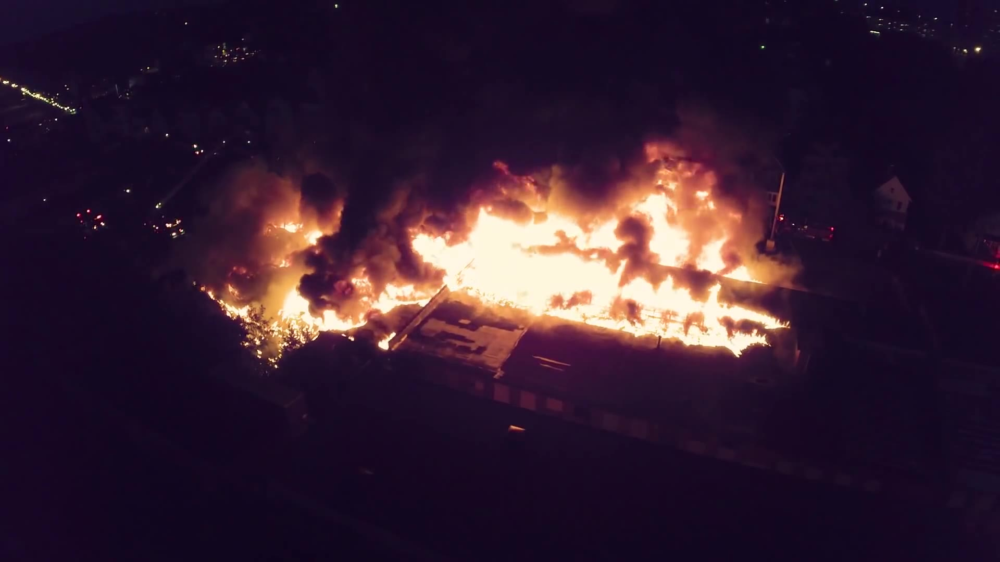

In [27]:
from PIL import Image
im = (Image.open('test/fire/F_2062.jpg'))
im